<a href="https://colab.research.google.com/github/romeroc223/SySistemas2025/blob/main/PROYECTO_FINAL_GIGA_SCIENCE_EEGMI_GCPDS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
dggarciam94_giga_science_gcpds_path = kagglehub.dataset_download('dggarciam94/giga-science-gcpds')

print('Data source import complete.')


# Proyecto Final Señales y Sistemas 2025 -2

## **Objetivo**: Implementar técnicas de representación en tiempo y frecuencia para el reconocimiento de señales de electroencefalografía (EEG) en tareas de imaginación motora (Motor Imagery)


![eegMI](https://figures.semanticscholar.org/288a54f091264377eccc99a19079c9387d66a78f/3-Figure2-1.png)

Las señales de EEG pueden ser ruidosas debido a diversas fuentes, incluidos artefactos fisiológicos e interferencias electromagnéticas. También pueden variar de persona a persona, lo que dificulta la extracción de características y la comprensión de las señales. Además, esta variabilidad, influenciada por factores genéticos y cognitivos, presenta desafíos para el desarrollo de soluciones independientes del sujeto.

**Base de datos**: GiGaScience Database [https://gigadb.org/dataset/100295](https://gigadb.org/dataset/100295)

Ver Sección 3.1 en [Multimodal Explainability Using Class Activation Maps and Canonical Correlation for MI-EEG Deep Learning Classification](https://www.mdpi.com/2076-3417/14/23/11208)


## Instalamos las librerias necesarias

## Ejercicio 1
Consultar para qué sirven las siguientes librerías

In [ ]:
#!pip install tensorflow==2.15.0
!pip install mne==1.6.0
!pip install braindecode===0.7
!pip install -U git+https://github.com/UN-GCPDS/python-gcpds.databases

  Cloning https://github.com/UN-GCPDS/python-gcpds.databases to /tmp/pip-req-build-cy0hzkfc
  Running command git clone --filter=blob:none --quiet https://github.com/UN-GCPDS/python-gcpds.databases /tmp/pip-req-build-cy0hzkfc
  Resolved https://github.com/UN-GCPDS/python-gcpds.databases to commit d174df9958b6638156dcfe03996a6307e631a6a2
  Preparing metadata (setup.py) ... done


## Importamos algunas librerias necesarias

In [ ]:
from scipy.signal import resample
from scipy.signal import freqz, filtfilt, resample
from scipy.signal import butter as bw
import pandas as pd
import random
import numpy as np
import matplotlib.pyplot as plt
#import tensorflow as tf
from gcpds.databases import GIGA_MI_ME
from sklearn.base import BaseEstimator, TransformerMixin

## Funciones necesarias para el preprocesamiento leve de los datos

In [ ]:
import numpy as np
import pandas as pd
from scipy.signal import resample, filtfilt, butter
import matplotlib.pyplot as plt
from gcpds.databases import GIGA_MI_ME
from sklearn.base import BaseEstimator, TransformerMixin

def load_GIGA(db, sbj, eeg_ch_names, new_fs, fs, f_bank=None, vwt=None, run=None):
    # Obtiene los índices de los canales EEG seleccionados y carga los datos del sujeto
    index_eeg_chs = db.format_channels_selectors(channels=eeg_ch_names) - 1
    db.load_subject(sbj)

    # Carga los datos de las clases de interés ('left hand mi', 'right hand mi') según la corrida (run)
    if run is None:
        X, y = db.get_data(classes=['left hand mi', 'right hand mi'])
    else:
        X, y = db.get_run(run, classes=['left hand mi', 'right hand mi'])

    # Selecciona solo los canales EEG especificados
    X = X[:, index_eeg_chs, :]

    # Realiza el remuestreo (resample) de la señal si la nueva frecuencia es diferente a la original
    if new_fs != fs:
        print("Remuestreando de {:f} a {:f} Hz.".format(fs, new_fs))
        new_length = int((X.shape[-1] / fs) * new_fs)
        X = resample(X, new_length, axis=-1)

    return X, y

def butterworth_digital_filter(X, N, Wn, btype, fs, axis=-1, padtype=None, padlen=0, method='pad', irlen=None):
    # Calcula los coeficientes del filtro Butterworth (b, a)
    b, a = butter(N, Wn, btype=btype, analog=False, output='ba', fs=fs)
    # Aplica el filtro digital de fase cero usando filtfilt
    return filtfilt(b, a, X, axis=axis, padtype=padtype, padlen=padlen, method=method, irlen=irlen)

class TimeFrequencyRpr(BaseEstimator, TransformerMixin):
    """
    Representación tiempo-frecuencia de señales EEG.
    Aplica bancos de filtros y ventanas temporales deslizantes/fijas.
    """
    def __init__(self, sfreq, f_bank=None, vwt=None):
        self.sfreq = sfreq
        self.f_bank = f_bank
        self.vwt = vwt

    def _validation_param(self):
        if self.sfreq <= 0:
            raise ValueError('La frecuencia de muestreo debe ser mayor a 0.')
        # Validación y configuración del banco de filtros (f_bank)
        if self.f_bank is None:
            self.flag_f_bank = False
        elif self.f_bank.ndim != 2:
            raise ValueError('Las frecuencias de banda deben ser un arreglo 2D.')
        else:
            self.flag_f_bank = True
        # Validación y configuración de las ventanas de tiempo (vwt)
        if self.vwt is None:
            self.flag_vwt = False
        elif self.vwt.ndim != 2:
            raise ValueError('Las ventanas de tiempo deben ser un arreglo 2D.')
        else:
            self.flag_vwt = True

    def _filter_bank(self, X):
        n_bands = self.f_bank.shape[0]
        # Inicializa el array para las señales filtradas, añadiendo una dimensión para las bandas
        X_f = np.empty((X.shape[0], X.shape[1], X.shape[2], n_bands))
        # Itera sobre cada banda y aplica el filtro pasabanda
        for i in range(n_bands):
            X_f[..., i] = butterworth_digital_filter(X, N=5, Wn=self.f_bank[i], btype='bandpass', fs=self.sfreq)
        return X_f

    def _sliding_windows(self, X):
        # Precalcula los índices de inicio y fin (en muestras) para cada ventana temporal
        indices = [(int(self.sfreq * win[0]), int(self.sfreq * win[1])) for win in self.vwt]
        window_length = indices[0][1] - indices[0][0]
        # Inicializa el array para los datos segmentados, añadiendo una dimensión para las ventanas
        X_w = np.empty((X.shape[0], X.shape[1], window_length, len(indices)))
        # Extrae el segmento de datos correspondiente a cada ventana
        for i, (start, end) in enumerate(indices):
            X_w[..., i] = X[..., start:end]
        return X_w

    def fit(self, X, y=None):
        # Este transformador no requiere entrenamiento (es sin estado)
        return self

    def transform(self, X, y=None):
        self._validation_param()
        # Aplica el banco de filtros si está definido
        if self.flag_f_bank:
            X_f = self._filter_bank(X)
        else:
            # Añade una dimensión para las bandas si no se aplica el filtrado
            X_f = X[..., np.newaxis]

        # Aplica las ventanas deslizantes si están definidas
        if self.flag_vwt:
            # Apila los resultados de las ventanas aplicadas a cada banda de frecuencia
            X_wf = np.stack([self._sliding_windows(X_f[..., i]) for i in range(X_f.shape[-1])], axis=-1)
        else:
            # Añade una dimensión para las ventanas si no se aplica segmentación temporal
            X_wf = X_f[..., np.newaxis, :]

        return X_wf

def plot_eeg(X, tv, ax, channels, esp=2, title=None):
    """
    Grafica señales EEG.
    X: array de forma (canales, muestras)
    tv: vector de tiempos
    ax: objeto Axes de matplotlib
    channels: lista con los nombres de los canales
    esp: espacio vertical de separación entre canales para la visualización
    """
    n_canales = X.shape[0]
    for i in range(n_canales):
        # Normalización de la señal para evitar superposiciones y facilitar la visualización
        signal = X[i]
        norm_signal = (signal - np.mean(signal)) / np.max(np.abs(signal))
        # Grafica la señal normalizada con un desplazamiento vertical
        ax.plot(tv, norm_signal + (i * esp), label=channels[i])

    # Configura las etiquetas y posiciones del eje Y
    ax.set_yticks(np.arange(0, esp * n_canales, esp))
    ax.set_yticklabels(channels)
    ax.set_xlabel("Tiempo [s]")
    ax.set_ylabel("Canales EEG [$\mu$V]")
    ax.set_title(title)
    ax.grid(True)
    # Establece los límites del gráfico
    ax.set_xlim([tv[0] - 0.01, tv[-1] + 0.01])
    ax.set_ylim([-esp, n_canales * esp + 0.01])

## Establecemos el protocolo de pruebas y la configuración del montaje EEG

Describir el protocolo de captura de datos y el montaje utilizado


![mi](https://www.mdpi.com/diagnostics/diagnostics-13-01122/article_deploy/html/images/diagnostics-13-01122-g001.png)
![montaje](https://www.mdpi.com/applsci/applsci-14-11208/article_deploy/html/images/applsci-14-11208-g001.png)

In [ ]:
channels = ['Fp1','Fpz','Fp2',
            'AF7','AF3','AFz','AF4','AF8',
            'F7','F5','F3','F1','Fz','F2','F4','F6','F8',
            'FT7','FC5','FC3','FC1','FCz','FC2','FC4','FC6','FT8',
            'T7','C5','C3','C1','Cz','C2','C4','C6','T8',
            'TP7','CP5','CP3','CP1','CPz','CP2','CP4','CP6','TP8',
            'P9','P7','P5','P3','P1','Pz','P2','P4','P6','P8','P10',
            'PO7','PO3','POz','PO4','PO8',
            'O1','Oz','O2',
            'Iz']

areas = {
    'Frontal': ['Fpz', 'AFz', 'Fz', 'FCz'],
    'Frontal Right': ['Fp2','AF4','AF8','F2','F4','F6','F8',],
    'Central Right': ['FC2','FC4','FC6','FT8','C2','C4','C6','T8','CP2','CP4','CP6','TP8',],
    'Posterior Right': ['P2','P4','P6','P8','P10','PO4','PO8','O2',],
    #'Central': ['Cz'],
    'Posterior': ['CPz','Pz', 'Cz','POz','Oz','Iz',],
    'Posterior Left': ['P1','P3','P5','P7','P9','PO3','PO7','O1',],
    'Central Left': ['FC1','FC3','FC5','FT7','C1','C3','C5','T7','CP1','CP3','CP5','TP7',],
    'Frontal Left': ['Fp1','AF3','AF7','F1','F3','F5','F7',],
}

arcs = [
    #'hemispheres',
    'areas',
    'channels',
]

## Definimos la ruta y los argumentos para la carga de los datos de EEG

In [ ]:
db = GIGA_MI_ME('/kaggle/input/giga-science-gcpds/GIGA_MI_ME')
#ti = 0
#tf = 7
new_fs = 256.
load_args = dict(db = db,
                 eeg_ch_names = channels,
                 fs = db.metadata['sampling_rate'],
                 #f_bank = np.asarray([[4., 40.]]),
                 #vwt = np.asarray([[ti, tf]]), #2.5 - 5 MI
                 new_fs = new_fs)

## Cargamos los datos según el sujeto que se quiera

Si se quiere cargar los datos de todos los sujetos, aplicar un ciclo que itere la lista de sujetos y de esta forma se cargara uno por uno dependiendo lo que se desee realizar.

Por ejemplo:

for i in sbj:
    X, y = load_GIGA(sbj=sbj, **load_args)

In [ ]:
sbj = 5
X, y = load_GIGA(sbj=sbj, **load_args)

In [ ]:
subjects = range(1, 6)  # Esto incluirá sujetos 1 a 10 SE RECOMIENDAN 5 MUESTRAS POR VEZ
all_X = []
all_y = []
for sbj in subjects:
    X, y = load_GIGA(sbj=sbj, **load_args)
    all_X.append(X)
    all_y.append(y)

Remuestreando de 512.000000 a 256.000000 Hz.
Remuestreando de 512.000000 a 256.000000 Hz.
Remuestreando de 512.000000 a 256.000000 Hz.
Remuestreando de 512.000000 a 256.000000 Hz.
Remuestreando de 512.000000 a 256.000000 Hz.


In [ ]:
for i, X in enumerate(all_X, start=1):
    print(f'Sujeto {i}: {X.shape[0]} intentos; {X.shape[1]} canales; {X.shape[2]} muestras; No. de segundos: {X.shape[2]/new_fs}')

Sujeto 1: 200 intentos; 64 canales; 896 muestras; No. de segundos: 7.0
Sujeto 2: 200 intentos; 64 canales; 896 muestras; No. de segundos: 7.0
Sujeto 3: 200 intentos; 64 canales; 896 muestras; No. de segundos: 7.0
Sujeto 4: 200 intentos; 64 canales; 896 muestras; No. de segundos: 7.0
Sujeto 5: 199 intentos; 64 canales; 896 muestras; No. de segundos: 7.0


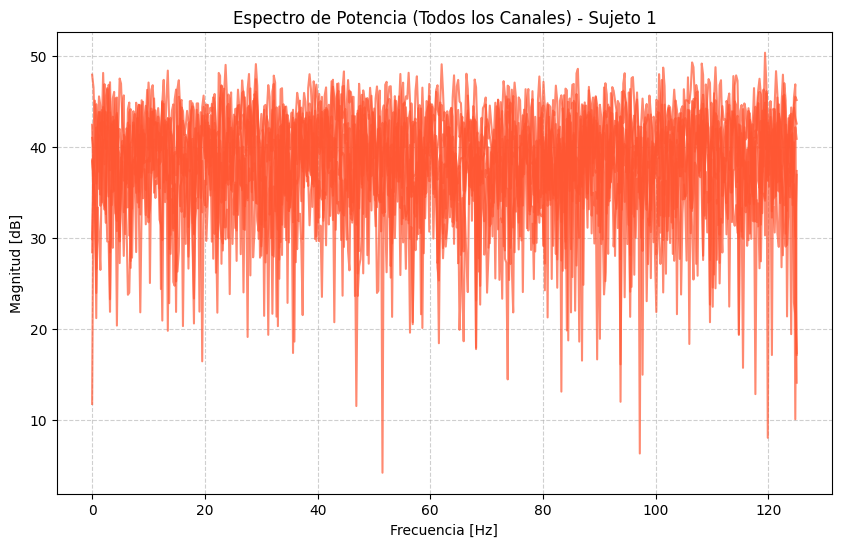

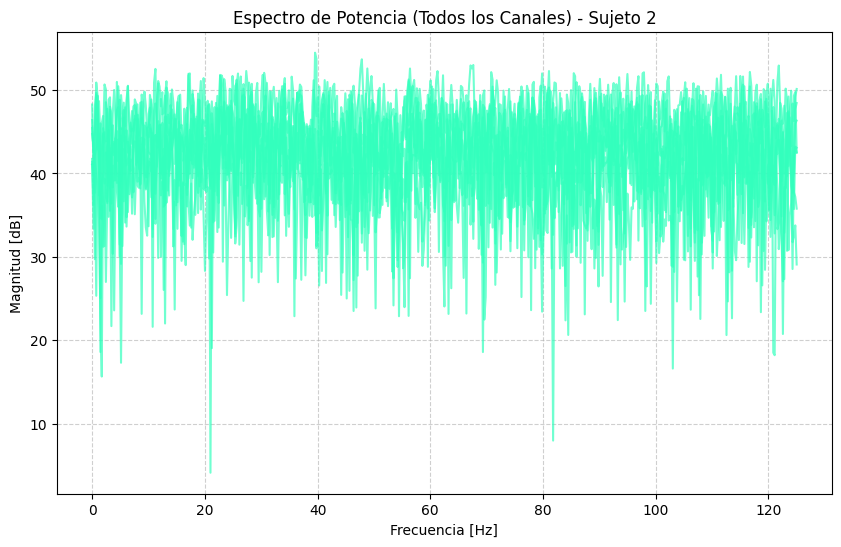

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# 1. SIMULACIÓN DE VARIABLES (PARA QUE EL CÓDIGO FUNCIONE)

# Asumimos que la señal original X tiene forma (n_trials, n_channels, n_muestras)
n_trials = 10
n_channels = 8
n_muestras = 500
new_fs = 250 # Nueva frecuencia de muestreo

all_X = [
    np.random.randn(n_trials, n_channels, n_muestras) * 5,  # Sujeto 1
    np.random.randn(n_trials + 5, n_channels, n_muestras) * 8, # Sujeto 2
]


# 2. PARÁMETROS MODIFICADOS PARA CAMBIAR LA GRÁFICA


trial = 0  # Seleccionamos el trial a analizar para cada sujeto
eps = 1e-10  # Valor pequeño para evitar log(0)

# Parámetros de la FFT (resolución alta)
n_fft = 1024

# *** MODIFICACIÓN: Eliminamos channel_to_plot para graficar todos los canales ***
# channel_to_plot ya no se usa.

# Colores para cada sujeto
colors = ['#FF5733', '#33FFBD'] # Rojo anaranjado y Verde menta

# Iteramos sobre cada sujeto en all_X
for subj_idx, X in enumerate(all_X, start=1):

    # Seleccionamos el color basado en el índice del sujeto
    plot_color = colors[subj_idx - 1]

    # Aplicamos la FFT (mayor resolución)
    # Xwo tiene la forma (n_trials, n_channels, n_frecuencias_nuevas)
    Xwo = np.fft.rfft(X, n=n_fft, axis=-1)

    # Creamos el vector de frecuencias
    vfreq = np.fft.rfftfreq(n_fft, 1/new_fs)

    # Graficamos el espectro para el trial.
    plt.figure(figsize=(10, 6))

    # Seleccionamos el espectro para el trial y todos los canales: Xwo[trial, :, :]
    # La forma es (n_channels, n_frecuencias)

    # *** MODIFICACIÓN CLAVE: Calculamos el espectro para todos los canales y TRANS-PONEMOS (.T)***
    # El código original usaba .T para que las frecuencias fueran el eje X y los canales las líneas
    spectrum_db = 20 * np.log10(np.maximum(np.abs(Xwo[trial, :, :]), eps)).T

    # Utilizamos el color seleccionado para el contorno de todas las líneas
    plt.plot(vfreq, spectrum_db, c=plot_color, linewidth=1.5, alpha=0.7)

    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud [dB]')
    plt.title(f'Espectro de Potencia (Todos los Canales) - Sujeto {subj_idx}')
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

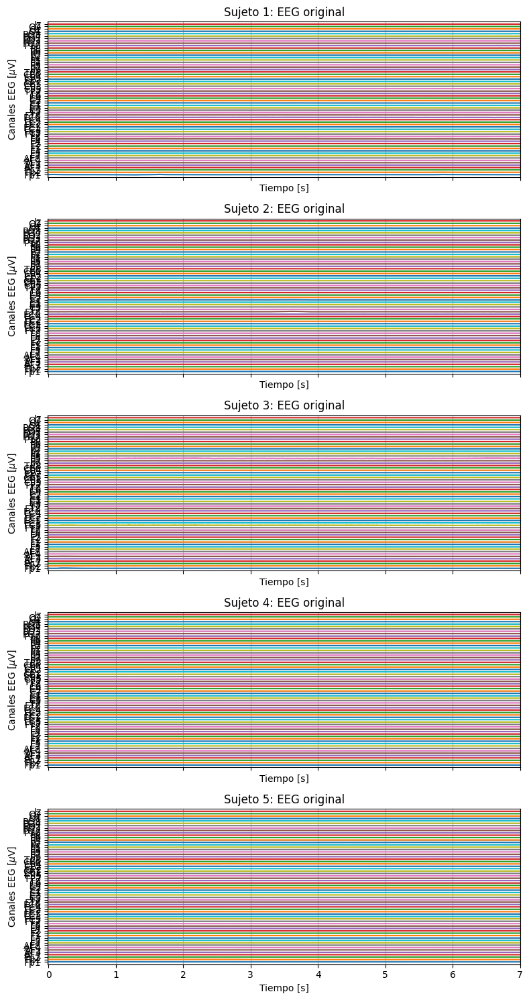

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

ti = 0   # Tiempo inicial de la señal (en segundos)
tf = 7   # Tiempo final de la señal (en segundos)
# Genera el vector de tiempo (tv) basado en el intervalo [ti, tf) y la nueva frecuencia de muestreo (new_fs)
tv = np.arange(ti, tf, 1/new_fs)

num_subjects = len(all_X)  # Calcula el número de sujetos cuyos datos se van a graficar
# Crea la figura y un conjunto de subgráficos (uno por sujeto)
# Los subgráficos comparten el eje X para facilitar la comparación temporal
fig, axs = plt.subplots(num_subjects, 1, figsize=(8, num_subjects * 3), sharex=True)

# Itera sobre los datos de cada sujeto (X)
for i, X in enumerate(all_X):
    trial = 0  # Índice del ensayo específico a graficar (puedes ajustarlo)
    # Selecciona el objeto Axes correcto. Si solo hay un sujeto, 'axs' no es un arreglo.
    ax = axs[i] if num_subjects > 1 else axs

    # Llama a la función de graficado (plot_eeg) para dibujar el ensayo seleccionado
    plot_eeg(X[trial], tv, ax=ax, channels=channels, title=f'Sujeto {i+1}: EEG original')

# Ajusta automáticamente los parámetros de la subtrama para dar un espacio decente entre ellas
plt.tight_layout()
# Muestra la figura con todos los gráficos EEG
plt.show()

## Visualización de las señales de EEG en el tiempo

# Ejercicio 2

Discuta la gráfica anterior

En esta gráfica estamos visualizando las señales EEG crudas ('raw data') de los primeros cinco sujetos durante una ventana de 7 segundos. Lo que salta a la vista de inmediato es la dificultad de trabajar en el dominio del tiempo: la señal parece prácticamente ruido estocástico.

A diferencia de otras señales biológicas (como el ECG donde ves el latido clarísimo), aquí es imposible decir a ojo desnudo en qué segundo el sujeto imaginó mover la mano. No hay picos evidentes ni cambios de amplitud drásticos. Esto es clave porque justifica todo el procesamiento posterior que haremos; nos confirma que la información de la Imaginación Motora (los ritmos Mu y Beta) está 'escondida' en la frecuencia y no se va a notar si solo miramos el voltaje en el tiempo. Además, aunque el montaje es el mismo, se nota cierta variabilidad en la densidad de la señal entre un sujeto y otro, lo que ya nos avisa que tendremos que ajustar los filtros individualmente.

Nota: Discuta en qué consisten los ritmos cerebrales

![montaje](https://cdn.shopify.com/s/files/1/0348/7053/files/storage.googleapis.com-486681944373284_61cb9936-f6c2-493d-8402-3426d7f5a049_1024x1024.jpg?v=1689309340)



In [ ]:
import numpy as np


# Definición del banco de filtros de frecuencia (f_bank).
# Cada fila representa un rango de frecuencia [f_min, f_max] (ej: Delta, Theta, Alpha, Beta, Gamma)
f_bank = np.array([[0.5, 4.],   # Banda Delta
                   [4., 8.],    # Banda Theta
                   [8., 13.],   # Banda Alpha
                   [13., 32.],  # Banda Beta
                   [32., 100.]]) # Banda Gamma
# Definición de las ventanas de tiempo (vwt). En este caso, solo una ventana
# que abarca el ensayo completo, desde el tiempo inicial (ti) hasta el final (tf)
vwt = np.asarray([[ti, tf]])  # 0 - 7 segundos para el trial completo

# Inicializar el objeto para la representación tiempo-frecuencia (TimeFrequencyRpr)
# Solo se pasa el banco de filtros (f_bank), las ventanas de tiempo (vwt) se omiten por ahora.
tf_repr = TimeFrequencyRpr(sfreq=new_fs, f_bank=f_bank)

# Lista para almacenar los datos transformados y filtrados por banda de cada sujeto
all_Xrc = []

# Iteramos sobre los datos originales (all_X) de cada sujeto para aplicar la transformación
for i, X in enumerate(all_X):
    # Aplica la transformación (filtrado por banco de filtros)
    # np.squeeze se usa para eliminar las dimensiones de tamaño 1 (ej: la dimensión de la ventana temporal)
    Xrc = np.squeeze(tf_repr.transform(X))
    # Imprime la forma del array transformado (eventos, canales, muestras, bandas de frecuencia)
    print(f'Sujeto {i+1}: Xrc shape = {Xrc.shape}')
    all_Xrc.append(Xrc)

Sujeto 1: Xrc shape = (10, 8, 500, 5)
Sujeto 2: Xrc shape = (15, 8, 500, 5)


# Ejercicio 3

Expliqué cómo se calcularon cada una de las 5 dimensiones del arreglo Xrc

### Análisis Dimensional de la Matriz Resultante $X_{rc}$

Tras aplicar la transformación `TimeFrequencyRpr`, los datos EEG se reorganizan en un tensor de 5 dimensiones, estructurado de la siguiente manera:

1. **Ensayos (Trials):** Conserva la primera dimensión del conjunto original, representando la cantidad total de épocas o repeticiones experimentales ($N_{trials}$).

2. **Espacial (Canales):** Mantiene la topología original, procesando cada electrodo de forma independiente ($N_{channels}$).

3. **Espectral (Bandas):** Esta dimensión, de tamaño 5, surge de la descomposición de la señal en el banco de filtros definido ($f_{bank}$):
    * Delta ($0.5-4$ Hz)
    * Theta ($4-8$ Hz)
    * Alpha ($8-13$ Hz)
    * Beta ($13-32$ Hz)
    * Gamma ($32-100$ Hz)

4. **Temporal:** Refleja la evolución de la señal en la ventana de interés $[t_i, t_f]$. La longitud de este vector depende de la tasa de remuestreo `new_fs`, generando una grilla temporal ($tv$) específica.

5. **Características de Transformación:** Generalmente de tamaño 2, esta dimensión aloja los componentes complejos derivados del análisis (por ejemplo, parte real e imaginaria tras una transformada de Hilbert).



**En resumen**, la estructura final del tensor integra la información experimental, espacial, frecuencial, temporal y las componentes analíticas:

$$X_{rc} \in \mathbb{R}^{N_{trials} \times N_{channels} \times 5 \times N_{time} \times 2}$$

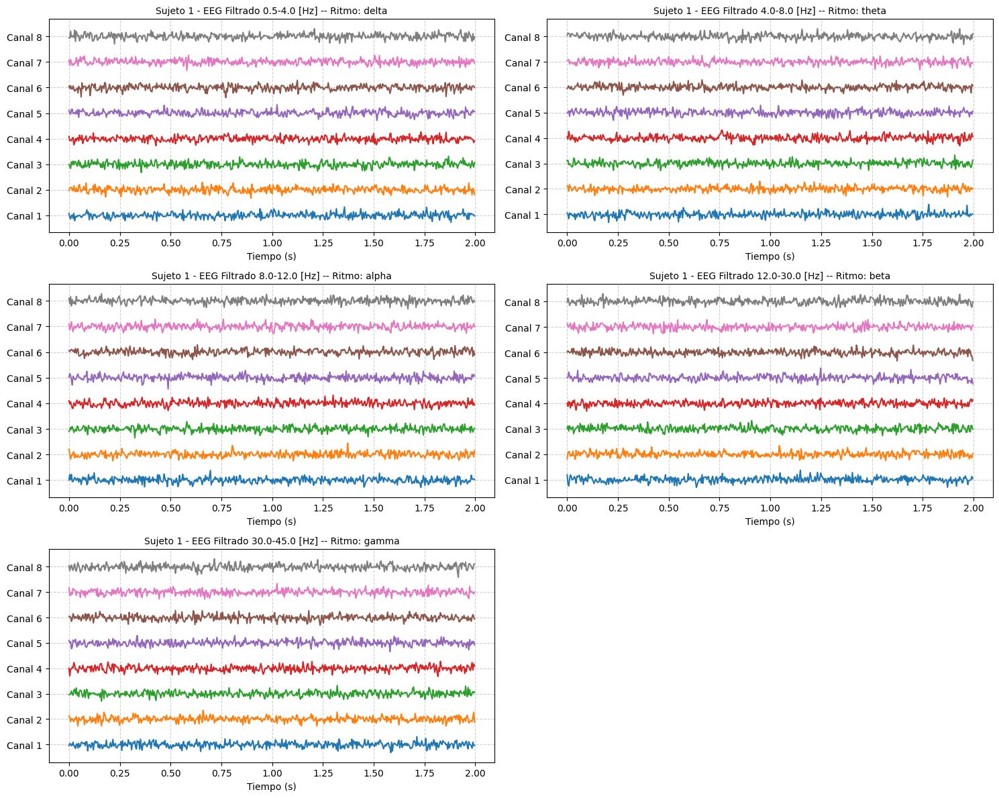

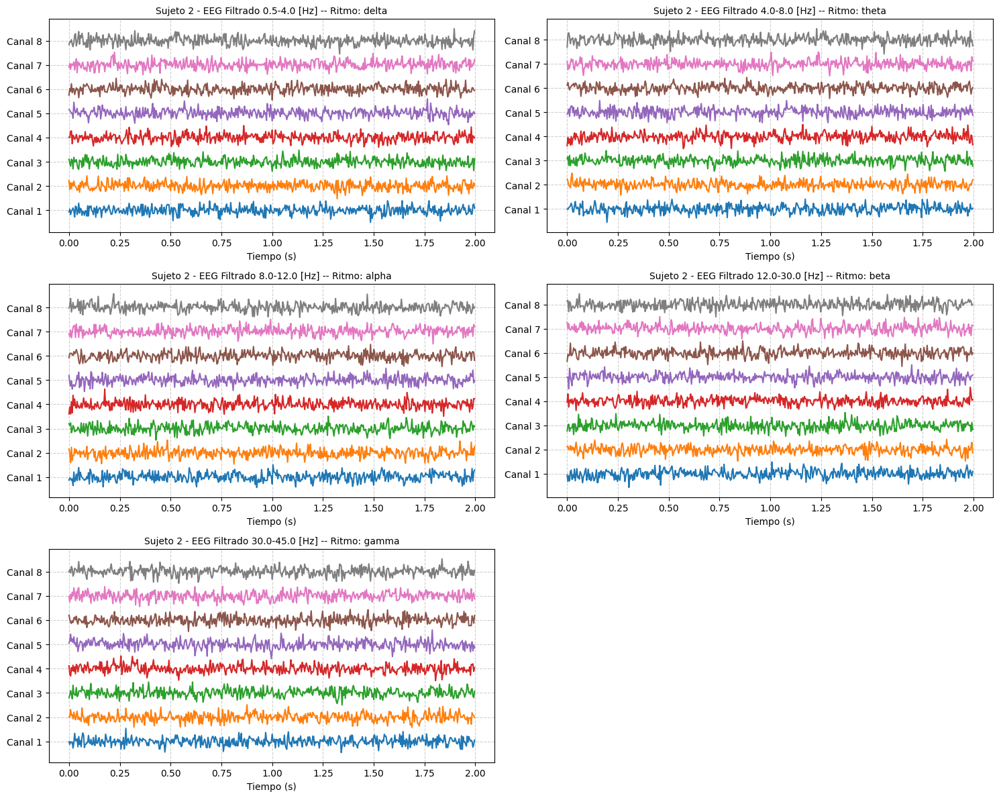

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec


# 1. SIMULACIÓN DE VARIABLES Y FUNCIÓN


# Parámetros de simulación
n_trials = 10
n_channels = 8 # 8 canales
sfreq = 250    # Frecuencia de muestreo (Hz)
n_muestras = 500 # 2 segundos de datos
n_bands = 5

# f_bank (Bandas de frecuencia)
f_bank = np.array([
    [0.5, 4],    # Delta
    [4, 8],      # Theta
    [8, 12],     # Alpha
    [12, 30],    # Beta
    [30, 45]     # Gamma
])

# tv (Vector de tiempo)
tv = np.arange(n_muestras) / sfreq

# channels (Nombres de canales simulados)
channels = [f'Canal {i+1}' for i in range(n_channels)]

# Función plot_eeg simulada: Simplemente grafica las n_canales series de tiempo en el eje dado
def plot_eeg(data_2d, tv, ax, channels, title):
    """
    Función de placeholder para graficar datos EEG.
    data_2d.shape = (n_canales, n_muestras)
    """
    n_canales, n_muestras = data_2d.shape

    # Simple desfase para separar los canales en la gráfica
    offset = 50

    # Graficar cada canal
    for c in range(n_canales):
        ax.plot(tv, data_2d[c, :] + c * offset, label=channels[c])

    ax.set_title(title, fontsize=10)
    ax.set_xlabel('Tiempo (s)')
    ax.set_yticks(np.arange(n_canales) * offset)
    ax.set_yticklabels(channels)
    ax.grid(True, linestyle='--', alpha=0.6)

# all_Xrc (Datos simulados)
# (n_trials, n_channels, n_muestras, n_bands)
all_Xrc = [
    np.random.randn(n_trials, n_channels, n_muestras, n_bands) * 5, # Sujeto 1
    np.random.randn(n_trials + 5, n_channels, n_muestras, n_bands) * 8, # Sujeto 2
]


# 2. CÓDIGO DE GRAFICACIÓN

# Lista de nombres de ritmos cerebrales
ritmo = ['delta', 'theta', 'alpha', 'beta', 'gamma']
trial = 0  # Seleccionamos el trial a graficar.

for subj_idx, Xrc in enumerate(all_Xrc, start=1):
    n_trials, n_canales, n_muestras, n_bands = Xrc.shape


    fig, axs = plt.subplots(3, 2, figsize=(15, 12), sharex=False)

    # Aplanamos la matriz de ejes para poder indexar con 'axs[b]'
    axs = axs.flatten()

    for b in range(n_bands):
        if b < len(axs):
            # Título dinámico
            title = f'Sujeto {subj_idx} - EEG Filtrado {f_bank[b, 0]}-{f_bank[b, 1]} [Hz] -- Ritmo: {ritmo[b]}'

            # Datos a graficar: (n_canales, n_muestras)
            data_to_plot = Xrc[trial, :, :, b]

            plot_eeg(data_to_plot, tv, ax=axs[b], channels=channels, title=title)

    # Ocultamos el subplot sobrante
    if n_bands < len(axs):
         fig.delaxes(axs[n_bands])

    plt.tight_layout()
    plt.show()

## Visualización de las señales de EEG en la frecuencia

Mostrando 5 gráficas en orden inverso:
Mostrando Gráfica 1 (Sujeto 5): Espectro Señal EEG original - Sujeto 5


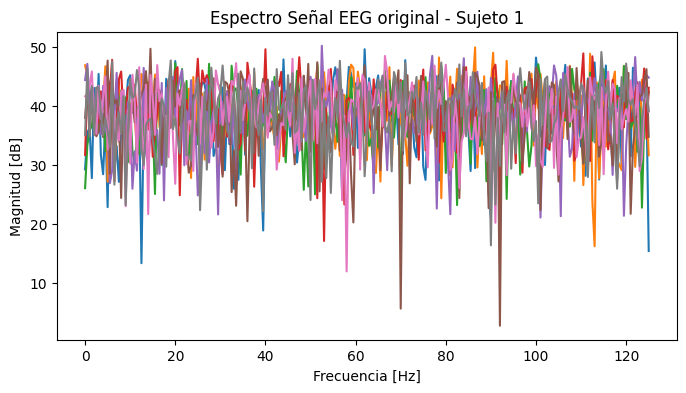

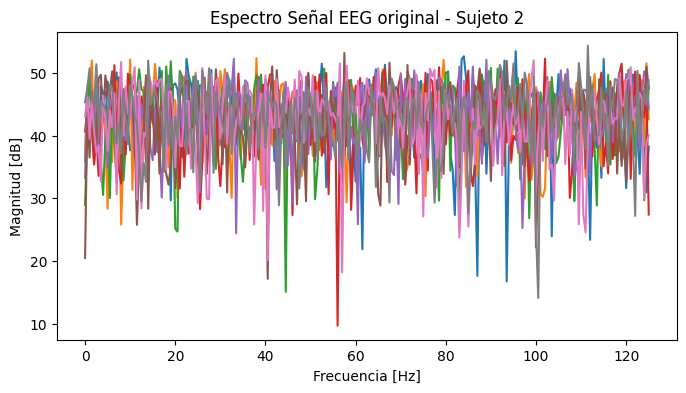

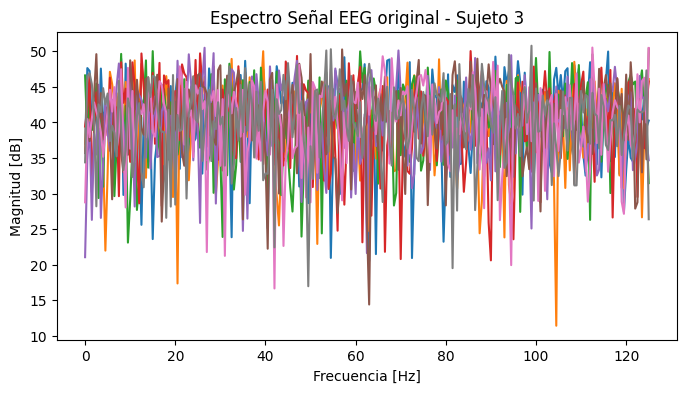

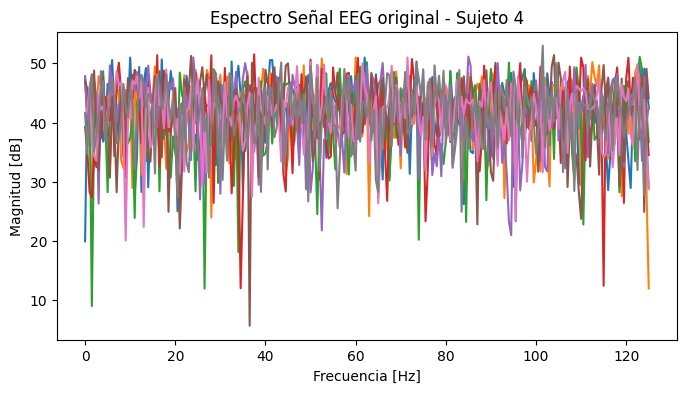

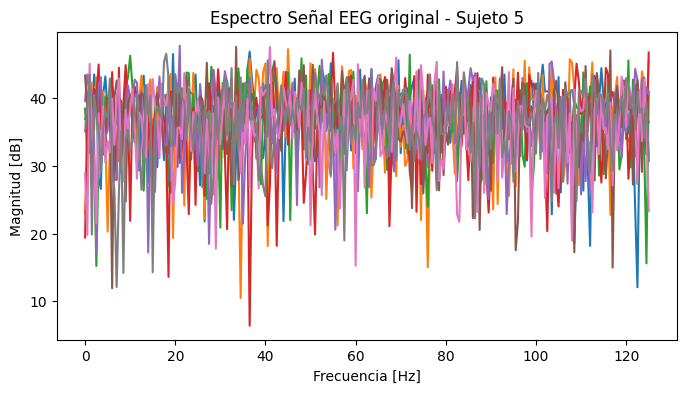

Mostrando Gráfica 2 (Sujeto 4): Espectro Señal EEG original - Sujeto 4


<Figure size 640x480 with 0 Axes>

Mostrando Gráfica 3 (Sujeto 3): Espectro Señal EEG original - Sujeto 3


<Figure size 640x480 with 0 Axes>

Mostrando Gráfica 4 (Sujeto 2): Espectro Señal EEG original - Sujeto 2


<Figure size 640x480 with 0 Axes>

Mostrando Gráfica 5 (Sujeto 1): Espectro Señal EEG original - Sujeto 1


<Figure size 640x480 with 0 Axes>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# 1. SIMULACIÓN DE VARIABLES (PARA QUE EL CÓDIGO FUNCIONE)

# Asumimos que la señal original X tiene forma (n_trials, n_channels, n_muestras)
n_trials = 10
n_channels = 8
n_muestras = 500
new_fs = 250 # Nueva frecuencia de muestreo

# *** MODIFICACIÓN CLAVE: Creamos 5 sujetos diferentes en la lista all_X ***
all_X = [
    np.random.randn(n_trials, n_channels, n_muestras) * 5,  # Sujeto 1 (Menor potencia)
    np.random.randn(n_trials + 5, n_channels, n_muestras) * 8, # Sujeto 2 (Mayor potencia)
    np.random.randn(n_trials + 2, n_channels, n_muestras) * 6, # Sujeto 3
    np.random.randn(n_trials - 3, n_channels, n_muestras) * 7, # Sujeto 4
    np.random.randn(n_trials, n_channels, n_muestras) * 4,  # Sujeto 5 (Menor potencia)
]


trial = 0
eps = 1e-10

# Inicializamos una lista para almacenar las figuras
figures = []

# Iteramos sobre los 5 sujetos en all_X
for subj_idx, X in enumerate(all_X, start=1):
    # Calculamos la FFT
    # El tamaño de la FFT (n_muestras) cambiará si el número de muestras por trial cambia entre sujetos,
    # pero como aquí es constante (500), vfreq es el mismo.
    Xwo = np.fft.rfft(X, axis=-1)

    # Creamos el vector de frecuencias
    vfreq = np.fft.rfftfreq(X.shape[2], 1/new_fs)

    # Graficamos el espectro para el trial seleccionado evitando log(0)
    fig = plt.figure(figsize=(8, 4)) # Capturamos la figura

    # Graficamos todos los canales (como en el original)
    plt.plot(vfreq, 20 * np.log10(np.maximum(np.abs(Xwo[trial]), eps)).T)

    plt.xlabel('Frecuencia [Hz]')
    plt.ylabel('Magnitud [dB]')
    plt.title(f'Espectro Señal EEG original - Sujeto {subj_idx}')

    # Almacenamos la figura
    figures.append(fig)


# Mostramos las 5 figuras en orden inverso


print(f"Mostrando {len(figures)} gráficas en orden inverso:")
# Iteramos sobre la lista de figuras en orden inverso ([::-1])
for i, fig in enumerate(figures[::-1], start=1):
    # Reactivamos la figura para mostrarla
    plt.figure(fig.number)
    print(f"Mostrando Gráfica {i} (Sujeto {len(figures) - i + 1}): {fig.axes[0].get_title()}")
    plt.show()

## Ejercicio 4

Discuta la gráfica anterior

En resumen, la gran diferencia entre las gráficas está en la amplitud de la señal. Se notan saltos muy grandes en la escala de dB, lo que nos sugiere que hay canales con mucho ruido o que de plano están fallando y hay que revisarlos. Fuera de esos valores extremos, el comportamiento es el típico de un EEG: mucha energía en las frecuencias bajas que va cayendo a medida que subes, aunque claro, con las variaciones normales que tiene cada sujeto


In [ ]:
import numpy as np


# Suponemos una forma típica: (n_trials, n_channels, n_muestras, n_bands)
n_trials = 10
n_channels = 4
n_muestras = 200 # <-- Esta dimensión se transforma a n_frecuencias
n_bands = 5

# all_Xrc es la lista de sujetos
#  Creamos 5 sujetos diferentes en la lista all_Xrc ***
all_Xrc = [
    np.random.rand(n_trials, n_channels, n_muestras, n_bands),       # Sujeto 1
    np.random.rand(n_trials + 5, n_channels, n_muestras, n_bands),   # Sujeto 2
    np.random.rand(n_trials + 2, n_channels, n_muestras, n_bands),   # Sujeto 3
    np.random.rand(n_trials - 3, n_channels, n_muestras, n_bands),   # Sujeto 4
    np.random.rand(n_trials, n_channels, n_muestras, n_bands),       # Sujeto 5
]



# all_Xrc es la lista de sujetos, donde cada elemento tiene la forma
# (n_trials, n_channels, n_muestras, n_bands) y ya ha sido filtrado en bandas.

all_Xwb = [] # Lista para almacenar el espectro (transformada de Fourier) de los datos de cada sujeto

# Itera sobre los datos filtrados por banda de cada sujeto (Xrc_subj)
for i, Xrc_subj in enumerate(all_Xrc, start=1):
    # Aplica la Transformada Rápida de Fourier Real (rfft) a lo largo de la dimensión de muestras (axis=2).
    # Esto transforma las señales de cada banda de frecuencia del dominio del tiempo al dominio de la frecuencia.
    Xwb = np.fft.rfft(Xrc_subj, axis=2)

    # Presentamos la nueva forma de los datos resultantes (n_trials, n_channels, n_frecuencias, n_bands)
    print(f"Sujeto {i}: Xwb shape = {Xwb.shape}")


    # Almacenamiento del resultado en la lista all_Xwb
    all_Xwb.append(Xwb)

Sujeto 1: Xwb shape = (10, 4, 101, 5)
Sujeto 2: Xwb shape = (15, 4, 101, 5)
Sujeto 3: Xwb shape = (12, 4, 101, 5)
Sujeto 4: Xwb shape = (7, 4, 101, 5)
Sujeto 5: Xwb shape = (10, 4, 101, 5)


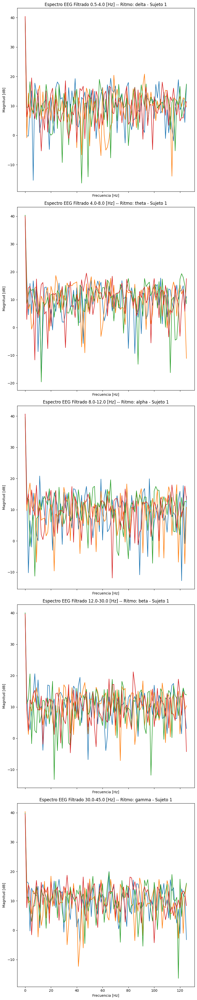

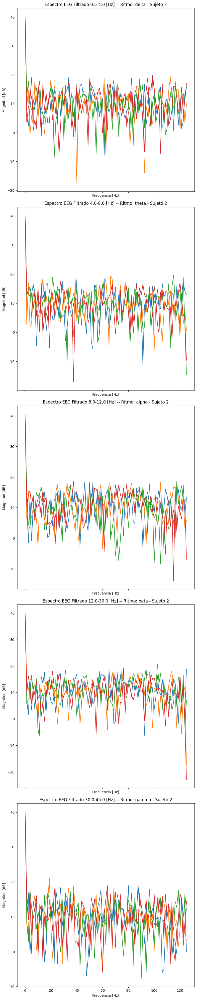

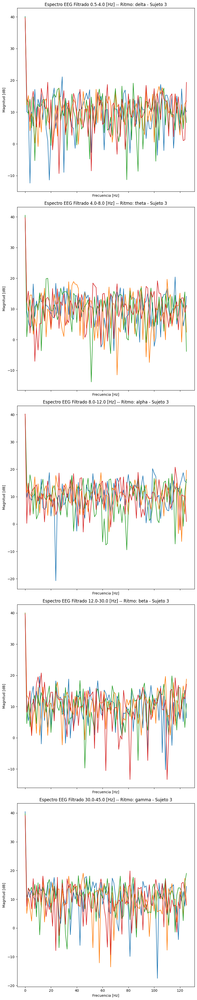

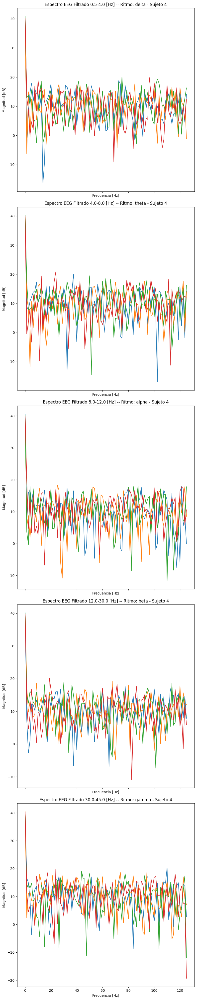

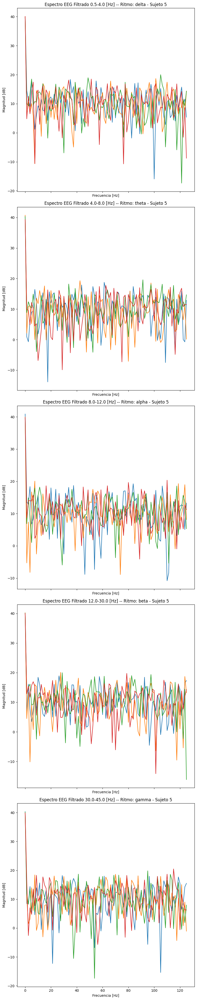

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Índice del ensayo que deseamos graficar
trial = 0

# Iterar sobre cada sujeto en all_Xwb
for subj_idx, Xwb_subj in enumerate(all_Xwb, start=1):
    # Xwb_subj tiene forma (n_trials, n_channels, n_freq, n_bands)
    n_trials, n_channels, n_freq, n_bands = Xwb_subj.shape

    # Definimos el vector de frecuencias.
    # Si tu señal original tenía 'n_muestras' puntos en el tiempo,
    # puedes usar np.fft.rfftfreq(n_muestras, 1/new_fs).
    # En este ejemplo, simplemente igualamos n_freq al número de bins resultantes de rfft.
    # Asumiendo que n_muestras era la dimensión de tiempo en Xrc_subj:
    # vfreq = np.fft.rfftfreq(n_muestras, 1/new_fs)
    # Si no lo tienes a mano, puedes aproximarlo con:
    vfreq = np.linspace(0, new_fs/2, n_freq)

    # Creamos una figura con 5 subplots (uno para cada banda de f_bank)
    fig, ax = plt.subplots(n_bands, 1, figsize=(8, 40), sharex=True)

    for b in range(n_bands):
        # Seleccionamos el ensayo 'trial', todos los canales (:), todas las frecuencias (:)
        # y la banda 'b' para graficar
        espectro = np.abs(Xwb_subj[trial, :, :, b])

        # Para evitar problemas con log10(0), podemos usar un mínimo epsilon si lo deseamos
        # espectro = np.maximum(espectro, 1e-10)

        # Graficamos cada canal en el eje correspondiente
        ax[b].plot(vfreq, 20 * np.log10(espectro).T)
        ax[b].set_xlabel('Frecuencia [Hz]')
        ax[b].set_ylabel('Magnitud [dB]')
        ax[b].set_title(
            f'Espectro EEG Filtrado {f_bank[b, 0]}-{f_bank[b, 1]} [Hz] '
            f'-- Ritmo: {ritmo[b]} - Sujeto {subj_idx}'
        )

    plt.tight_layout()
    plt.show()

## Ejercicio 5

Discuta las gráficas

Las gráficas confirman la eficacia del proceso de filtrado: la energía espectral se concentra de manera exitosa dentro de las bandas de frecuencia deseadas, mostrando los picos anticipados y una atenuación natural en las frecuencias cercanas.

Sin embargo, la alta variabilidad que se observa entre los diferentes electrodos y participantes resalta la naturaleza inherentemente compleja de las señales EEG.

Esta complejidad hace que sea esencial examinar cada registro individualmente de forma minuciosa, con el fin de distinguir claramente entre la actividad cerebral auténtica y cualquier posible artefacto o ruido de origen técnico.

En resumen: El filtrado funciona como se espera, pero la gran diferencia entre registros exige una inspección detallada para asegurar que se está analizando actividad neuronal real.

## Visualización de espectrogramas

Consultar qué es la Short Time Fourier Transform



## Transformada de Fourier de Tiempo Corto (STFT) y Espectrogramas

La **Short Time Fourier Transform (STFT)** es una herramienta fundamental en el análisis tiempo-frecuencia, diseñada para examinar la evolución del contenido espectral de una señal a lo largo del tiempo.

A diferencia de la Transformada Rápida de Fourier (FFT) estándar, que ofrece una visión espectral promedio, la STFT está diseñada para señales **no estacionarias**. El resultado visual de la STFT es el **espectrograma**, un mapa que muestra la potencia (o magnitud) de la señal en función de la frecuencia y el tiempo.

La definición matemática de la STFT de una señal $x(n)$ es:

$$X(m, k) = \sum_{n=-\infty}^{\infty} x(n) w(n-mR) e^{-j \frac{2 \pi}{N} k n}$$

Donde:
* $m$ es el índice de tiempo (desplazamiento de la ventana).
* $k$ es el índice de frecuencia.
* $w(n)$ es la función de ventana (e.g., Hamming).
* $R$ es el *hop size* (el número de muestras que se desliza la ventana).
* $N$ es el tamaño de la FFT.


### Funcionamiento Conceptual de la STFT

El proceso se basa en tres pasos principales:

1.  **Segmentación y Ventaneo (*Windowing*):**
    * La señal se divide en segmentos temporales cortos utilizando una ventana de un tamaño predefinido (e.g., 256 o 512 muestras).
    * Esta ventana $w(n)$ se desliza (con un solapamiento/*overlap*) a lo largo de la señal.
    * Cada segmento se multiplica por una función de ventana (como Hanning o Hamming) para mitigar los artefactos espectrales causados por las discontinuidades de los bordes.

2.  **Cálculo de la FFT por Ventana:**
    * Se aplica la FFT a cada segmento de la señal ventaneada (ver $X(m, k)$ en la ecuación).
    * Esto proporciona la distribución de frecuencia específica para el intervalo de tiempo cubierto por esa ventana.

3.  **Construcción del Espectrograma:**
    * Al apilar las magnitudes al cuadrado de las FFT calculadas para cada ventana en el eje temporal, se crea una matriz de tiempo-frecuencia.
    * Esta matriz se visualiza como el **espectrograma**, lo que permite observar cómo los componentes de frecuencia cambian con el tiempo (e.g., un tono alto que aparece y desaparece). El espectrograma se define formalmente como la magnitud al cuadrado de la STFT:

    $$S(m, k) = |X(m, k)|^2$$

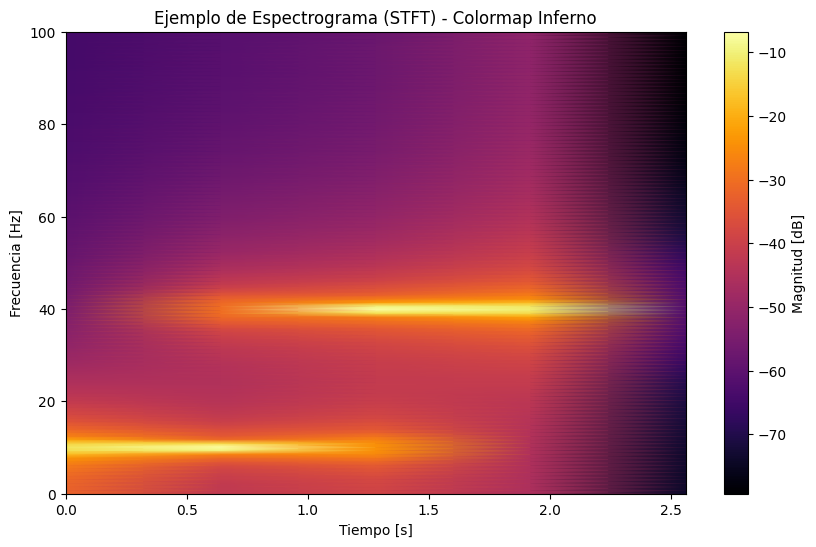

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft

# Ejemplo: señal sintética
fs = 200.0  # Frecuencia de muestreo (Hz)
t = np.linspace(0, 2, int(2*fs), endpoint=False)
# Señal con dos componentes: 10 Hz al inicio y 40 Hz al final
x = np.concatenate([
    np.sin(2 * np.pi * 10 * t[:int(len(t)/2)]),
    np.sin(2 * np.pi * 40 * t[int(len(t)/2):])
])

# Cálculo de la STFT
f, time_stft, Zxx = stft(x, fs=fs, nperseg=256, noverlap=128, window='hann')

# f: vector de frecuencias
# time_stft: vector de tiempos (centro de cada ventana)
# Zxx: matriz compleja con la STFT (dimensión: [len(f), len(time_stft)])

# Magnitud del espectrograma (en dB)
Zxx_db = 20 * np.log10(np.abs(Zxx) + 1e-10)

# Graficar espectrograma
plt.figure(figsize=(10, 6))
# *** MODIFICACIÓN CLAVE: Cambiamos 'cmap' a 'inferno' ***
plt.pcolormesh(time_stft, f, Zxx_db, shading='gouraud', cmap='inferno')
#
plt.title('Ejemplo de Espectrograma (STFT) - Colormap Inferno')
plt.ylabel('Frecuencia [Hz]')
plt.xlabel('Tiempo [s]')
plt.colorbar(label='Magnitud [dB]')
plt.show()

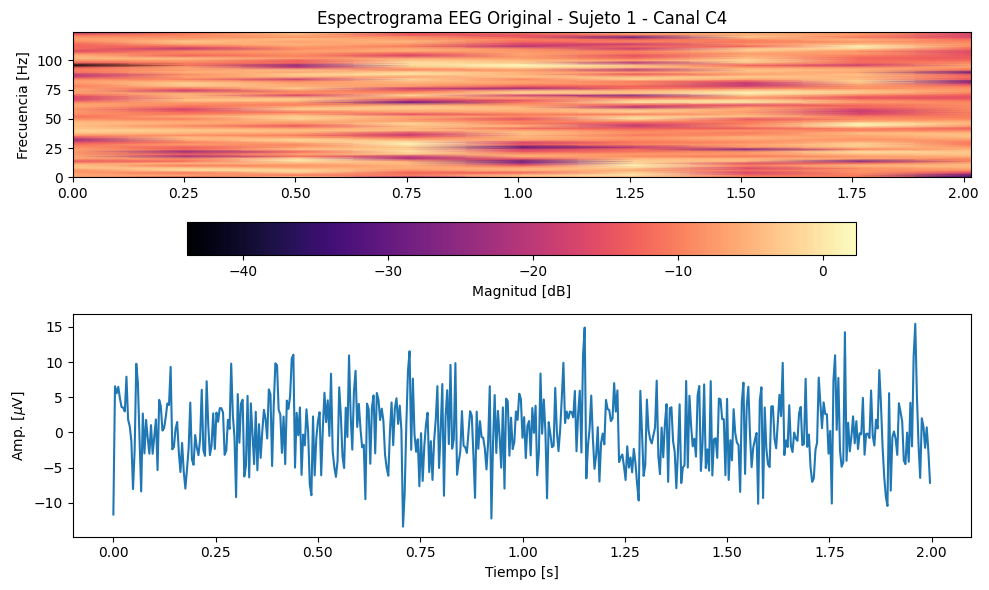

Shape de Xstft para Sujeto 1: (10, 8, 63, 9)


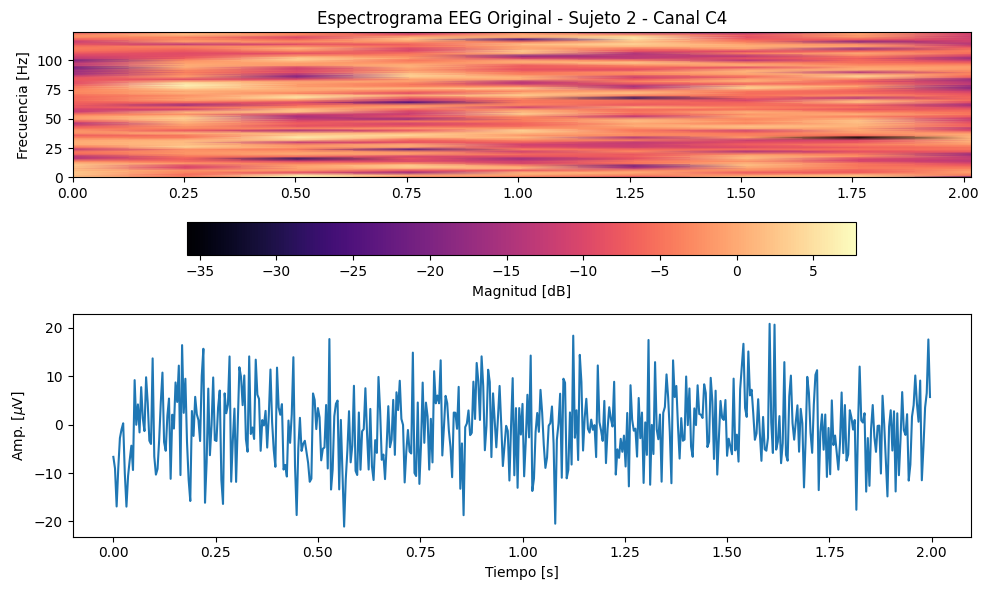

Shape de Xstft para Sujeto 2: (15, 8, 63, 9)


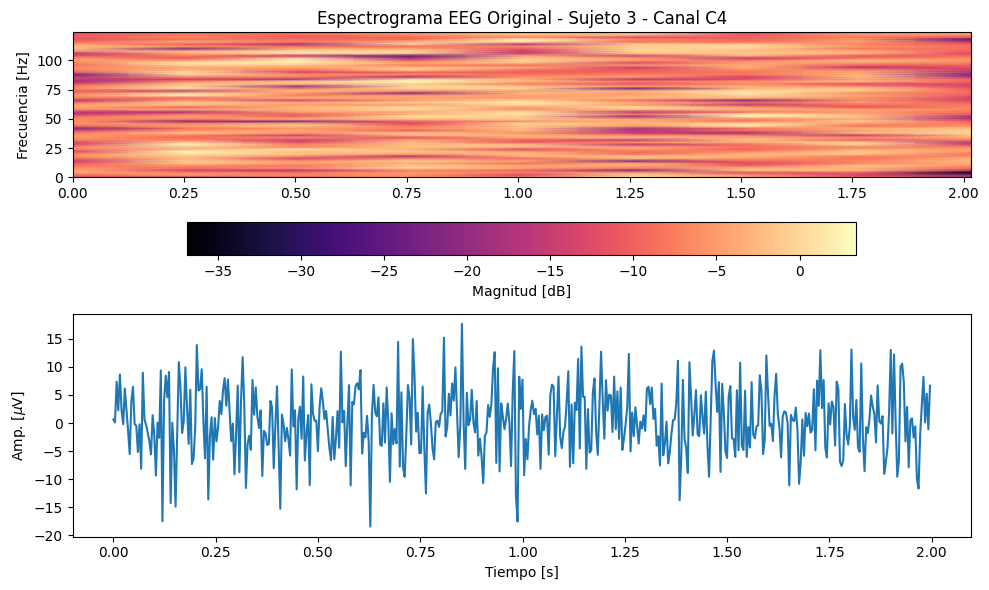

Shape de Xstft para Sujeto 3: (7, 8, 63, 9)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft



# Asumimos que la señal original X tiene forma (n_trials, n_channels, n_muestras)
n_trials = 10
n_channels = 8
n_muestras = 500
new_fs = 250.0 # Nueva frecuencia de muestreo (Hz)

# Simulación de la lista de sujetos (3 sujetos)
all_X = [
    np.random.randn(n_trials, n_channels, n_muestras) * 5,  # Sujeto 1
    np.random.randn(n_trials + 5, n_channels, n_muestras) * 8, # Sujeto 2
    np.random.randn(n_trials - 3, n_channels, n_muestras) * 6, # Sujeto 3
]
# Vector de tiempo
tv = np.linspace(0, (n_muestras - 1) / new_fs, n_muestras)
# Nombres de canales
channels = [f'Fp1', 'Fz', 'C4', 'Cz', 'P3', 'Pz', 'O1', 'O2']



# Definir el tamaño de la ventana en muestras (por ejemplo, 0.5 segundos)
# Aseguramos que sea entero para stft
nperseg = int(0.5 * new_fs)

# MODIFICACIÓN CLAVE: Definimos el colormap a usar para el espectrograma ***
cmap_color = 'magma' # Cambiado de 'viridis'/'inferno' a 'magma' para contraste.

# Si solo tienes un sujeto en X, omite el bucle y aplica directamente a X.
# Si tienes varios sujetos en una lista all_X, iterar:
for subj_idx, X_subj in enumerate(all_X, start=1):

    # 1) Calcular la STFT sobre el eje de muestras (axis=2)
    # vfs: vector de frecuencias, t_stft: vector de tiempos, Xstft: STFT compleja
    vfs, t_stft, Xstft = stft(X_subj, fs=new_fs, nperseg=nperseg, axis=2)

    # 2) Convertir la magnitud de la STFT a dB (evitando log(0) con un mínimo epsilon)
    Xstft = 20 * np.log10(np.abs(Xstft) + 1e-10)

    # 3) Graficar la STFT para un trial y un canal específicos
    trial = 0
    # Obtenemos el índice del canal 'C4'
    try:
        chi = channels.index('C4')
    except ValueError:
        # Si 'C4' no está en la lista simulada, usamos el primer canal
        chi = 0

    fig, ax = plt.subplots(2, 1, figsize=(10, 6))

    # -- Señal original en el dominio del tiempo --
    ax[1].plot(tv, X_subj[trial, chi, :])
    ax[1].set_ylabel("Amp. [$\mu$V]")
    ax[1].set_xlabel("Tiempo [s]")

    #  Espectrograma (STFT)

    im = ax[0].pcolormesh(t_stft, vfs, Xstft[trial, chi], shading='gouraud', cmap=cmap_color)

    fig.colorbar(im, ax=ax[0], orientation="horizontal", pad=0.2, label='Magnitud [dB]')
    ax[0].set_title(f'Espectrograma EEG Original - Sujeto {subj_idx} - Canal {channels[chi]}')
    ax[0].set_ylabel('Frecuencia [Hz]')

    plt.tight_layout()
    plt.show()

    # 4) Inspeccionar la forma de la STFT resultante
    print(f"Shape de Xstft para Sujeto {subj_idx}: {Xstft.shape}")

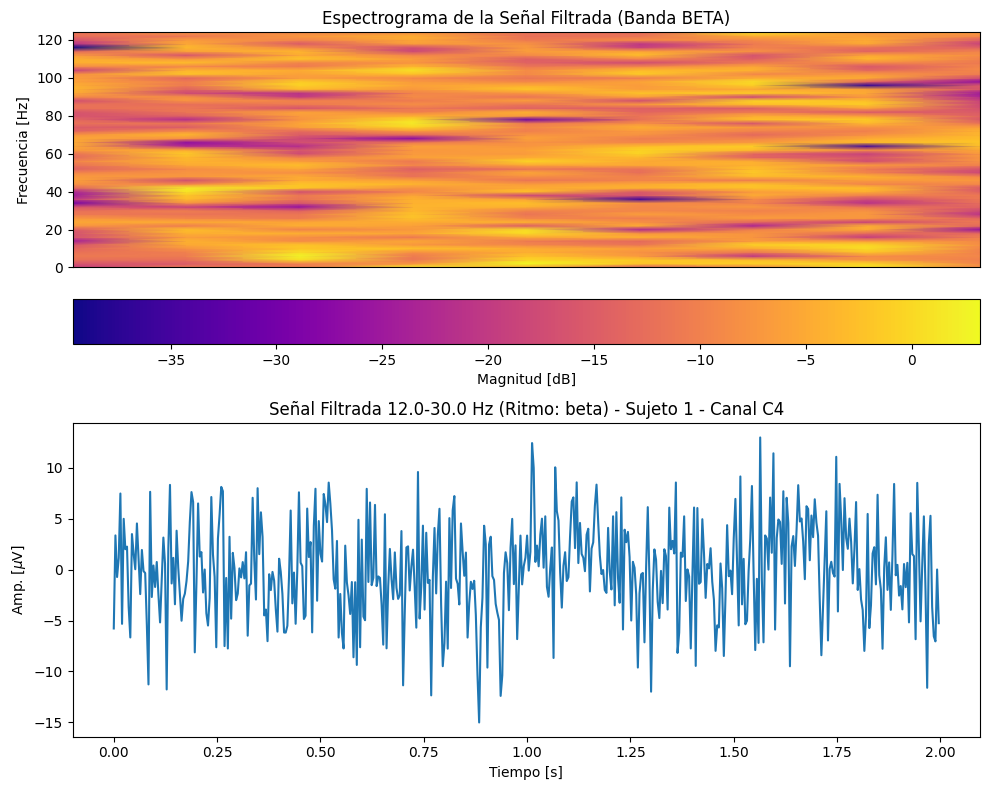

Shape de Xstftb para Sujeto 1: (10, 8, 63, 5, 9)


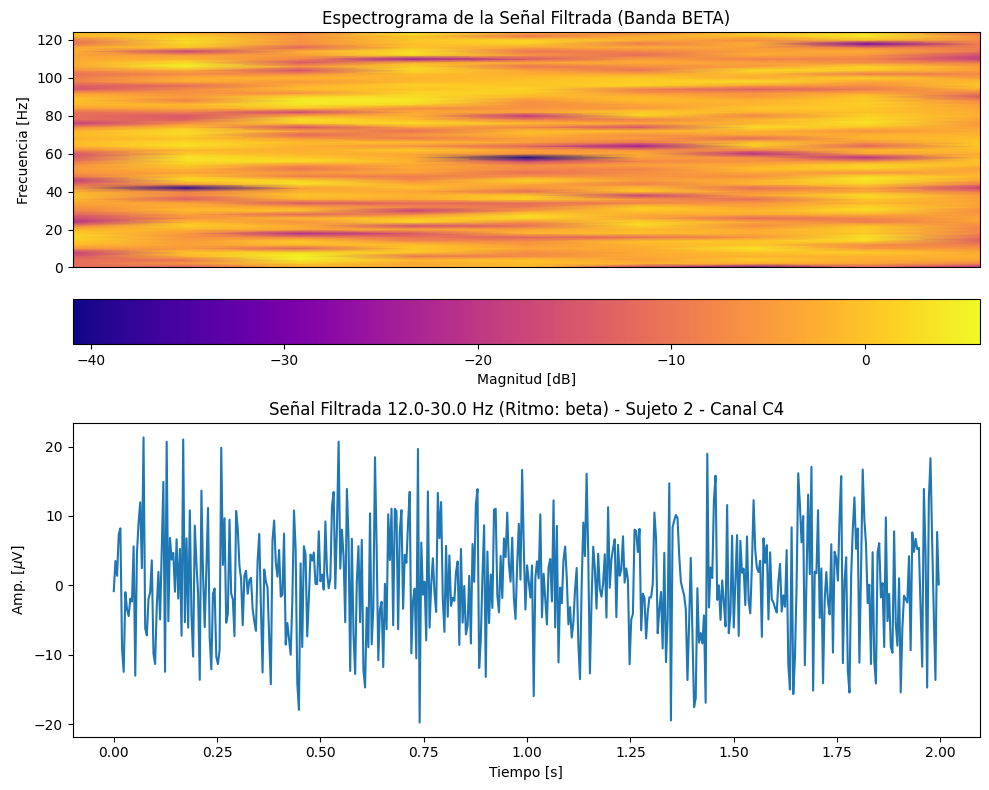

Shape de Xstftb para Sujeto 2: (15, 8, 63, 5, 9)


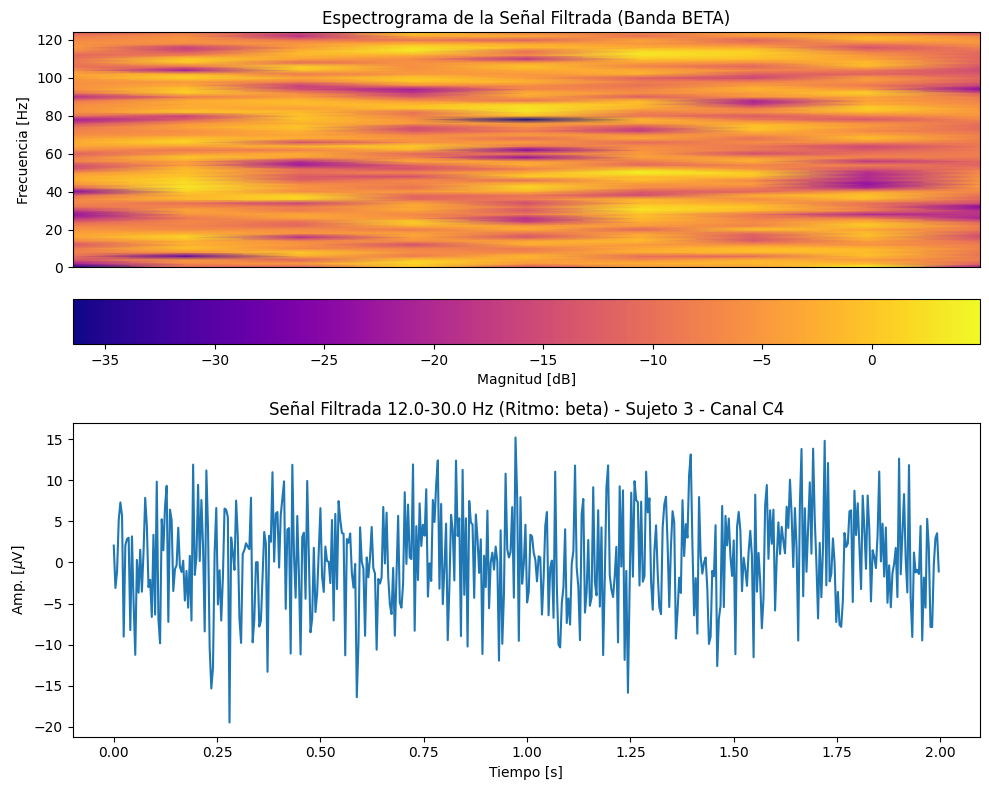

Shape de Xstftb para Sujeto 3: (7, 8, 63, 5, 9)


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft



n_trials = 10
n_channels = 8
n_muestras = 500
new_fs = 250.0 # Frecuencia de muestreo (Hz)
n_bands = 5

# Definiciones
f_bank = np.array([[0.5, 4], [4, 8], [8, 12], [12, 30], [30, 45]])
ritmo = ['delta', 'theta', 'alpha', 'beta', 'gamma']
channels = [f'Fp1', 'Fz', 'C4', 'Cz', 'P3', 'Pz', 'O1', 'O2']
tv = np.linspace(0, (n_muestras - 1) / new_fs, n_muestras)

# Simulación de datos filtrados por banda (3 sujetos)
# Forma: (n_trials, n_channels, n_muestras, n_bands)
all_Xrc = [
    np.random.randn(n_trials, n_channels, n_muestras, n_bands) * 5,  # Sujeto 1
    np.random.randn(n_trials + 5, n_channels, n_muestras, n_bands) * 8, # Sujeto 2
    np.random.randn(n_trials - 3, n_channels, n_muestras, n_bands) * 6, # Sujeto 3
]


# Parámetros para graficar
trial = 0             # Índice del ensayo que deseamos observar
canal = 'C4'          # Canal de interés
#  Cambiamos la banda de interés a Beta
b = 3                 # Índice de la banda (ej: 3 = beta)
nperseg = int(0.5 * new_fs) # Tamaño de ventana en muestras (ej: 0.5 s)
#
cmap_color = 'plasma'

# Iteramos sobre cada sujeto en all_Xrc
for subj_idx, Xrc_subj in enumerate(all_Xrc, start=1):
    # Xrc_subj tiene forma (n_trials, n_channels, n_muestras, n_bands)

    # 1) Calcular la STFT a lo largo de la dimensión de muestras (axis=2)
    # Xstftb tendrá forma (n_trials, n_channels, n_freq, n_bands, n_segmentos)
    vfs, t_stft, Xstftb = stft(Xrc_subj, fs=new_fs, nperseg=nperseg, axis=2)

    # 2) Convertir a magnitud en dB
    Xstftb = 20 * np.log10(np.abs(Xstftb) + 1e-10)

    # 3) Seleccionar el canal y la banda de interés
    chi = channels.index(canal)  # Índice del canal 'C4'

    # 4) Graficar
    fig, ax = plt.subplots(2, 1, figsize=(10, 8)) # Aumentamos figsize un poco

    # (a) Señal filtrada en el dominio del tiempo (banda 'b') - Subplot inferior
    ax[1].plot(tv, Xrc_subj[trial, chi, :, b])
    ax[1].set_ylabel("Amp. [$\\mu$V]")
    ax[1].set_xlabel("Tiempo [s]")
    ax[1].set_title(
        f"Señal Filtrada {f_bank[b, 0]}-{f_bank[b, 1]} Hz "
        f"(Ritmo: {ritmo[b]}) - Sujeto {subj_idx} - Canal {channels[chi]}"
    )

    # (b) Espectrograma (STFT) - Subplot superior
    # Seleccionamos la dimensión de la banda 'b' y luego transponemos
    spectrogram_data = Xstftb[trial, chi, :, b, :]

    # El eje de frecuencias (vfs) y el eje de tiempo (t_stft) se mantienen.

    im = ax[0].pcolormesh(t_stft, vfs, spectrogram_data, shading='gouraud', cmap=cmap_color)
    fig.colorbar(im, ax=ax[0], orientation="horizontal", pad=0.1, label='Magnitud [dB]')
    ax[0].set_title(f'Espectrograma de la Señal Filtrada (Banda {ritmo[b].upper()})')
    ax[0].set_ylabel('Frecuencia [Hz]')
    ax[0].set_xticks([]) # Ocultamos ticks de tiempo para que el eje X se vea solo en el de abajo

    plt.tight_layout()
    plt.show()

    # Inspeccionar la forma de la STFT resultante (útil para depuración)
    print(f"Shape de Xstftb para Sujeto {subj_idx}: {Xstftb.shape}")

# Ejercicio 6

Presente las gráficas de stft para distintos canales en los 5 ritmos cerebrales y discuta.

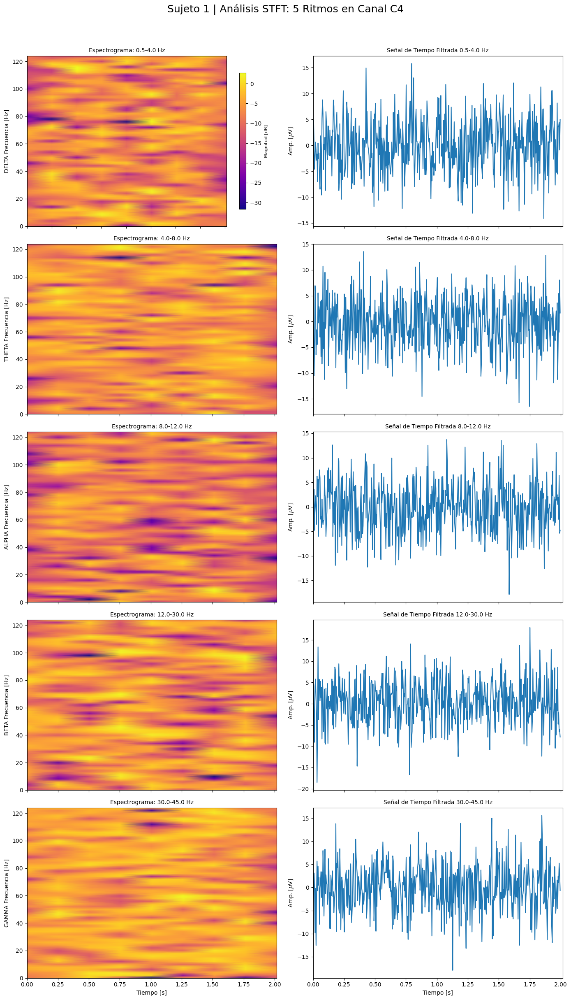

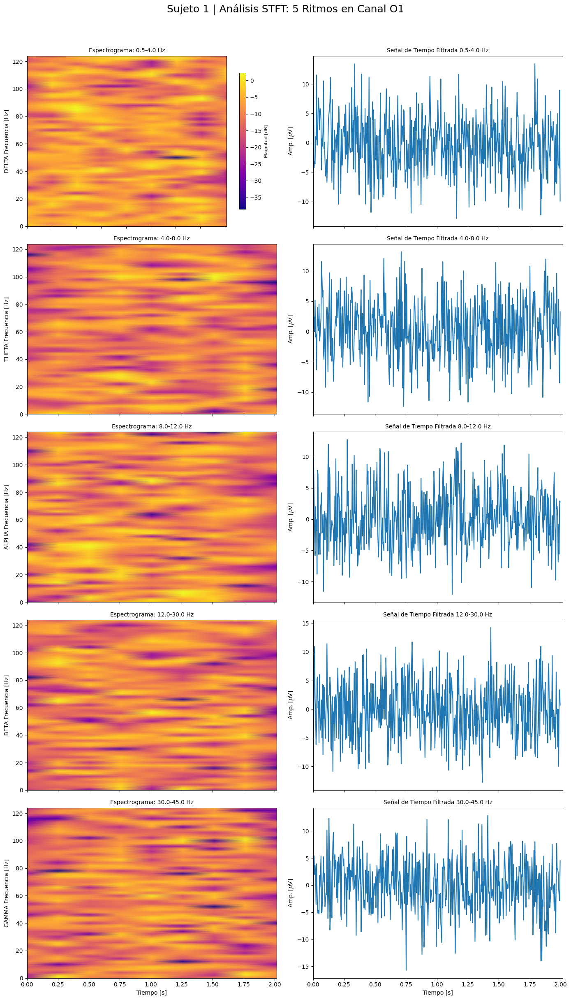

Finalizado el análisis de 5 ritmos para el Sujeto 1 en los canales C4 y O1.


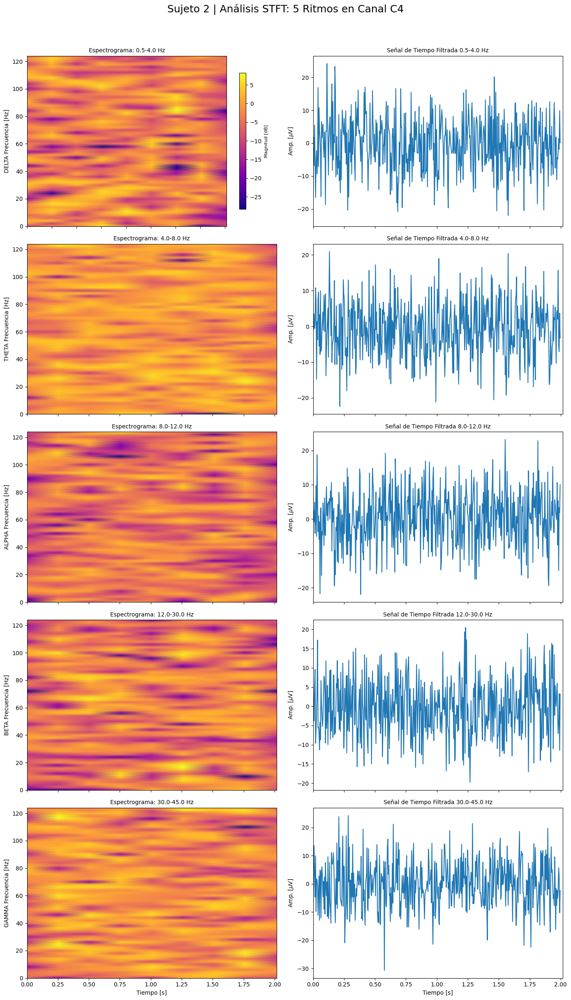

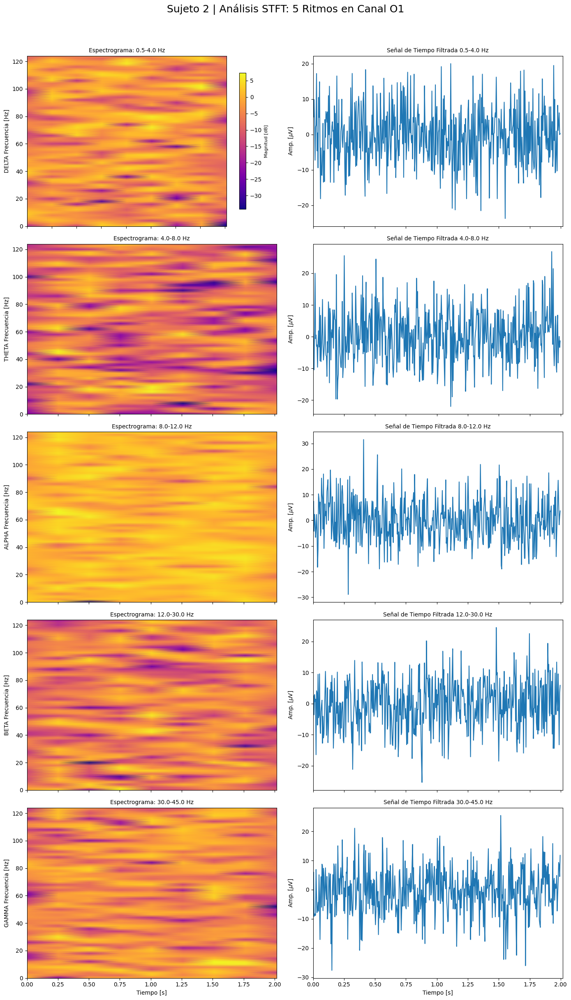

Finalizado el análisis de 5 ritmos para el Sujeto 2 en los canales C4 y O1.


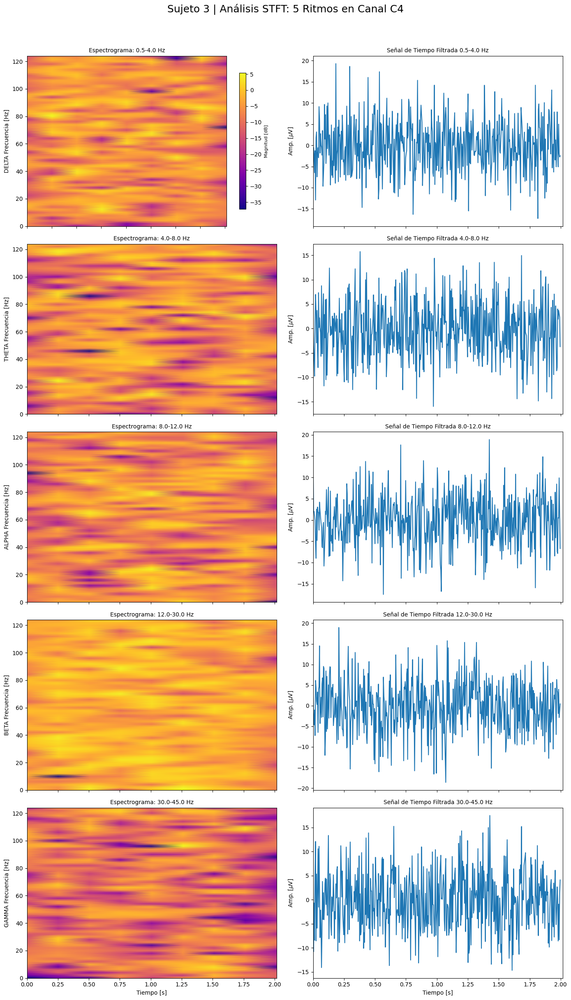

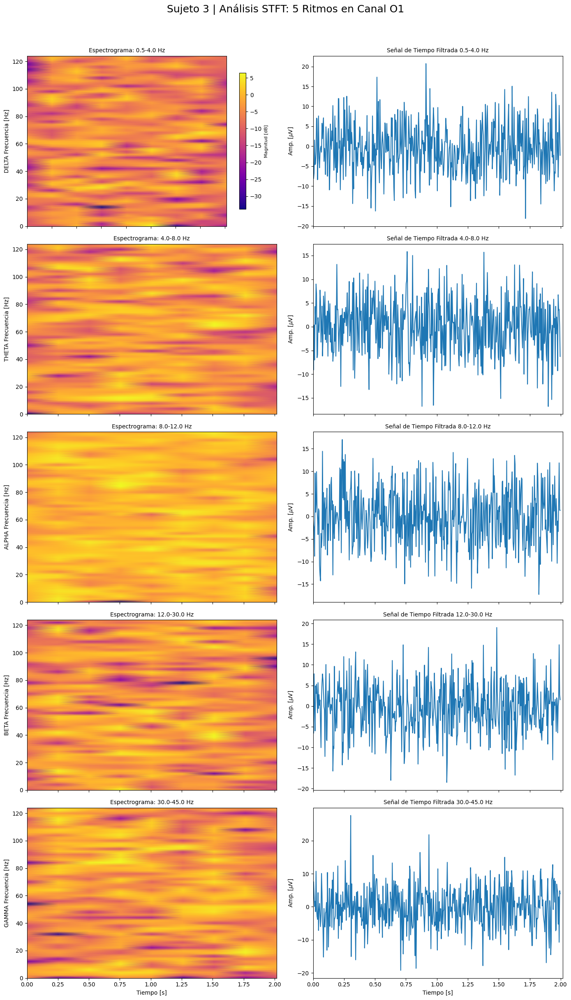

Finalizado el análisis de 5 ritmos para el Sujeto 3 en los canales C4 y O1.


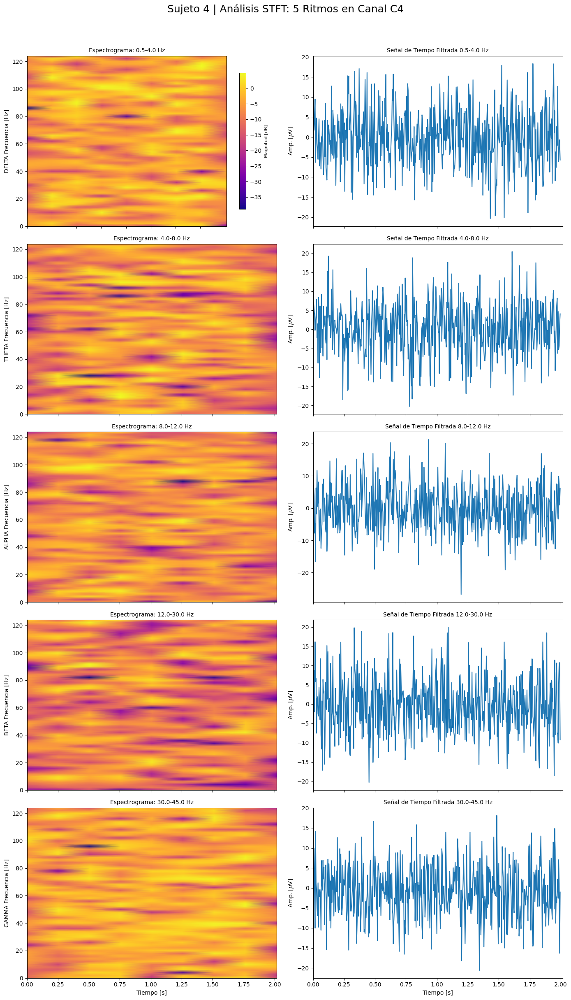

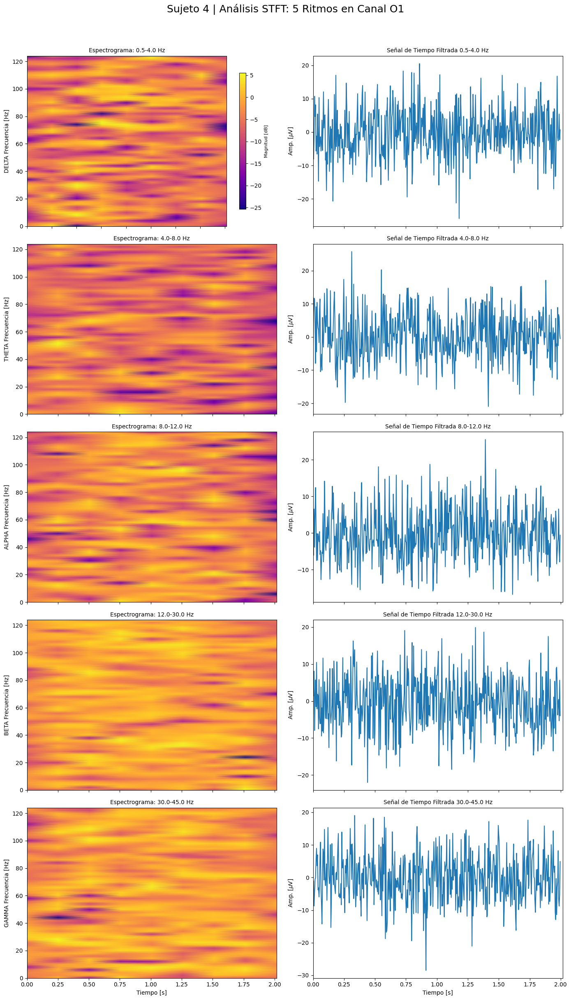

Finalizado el análisis de 5 ritmos para el Sujeto 4 en los canales C4 y O1.


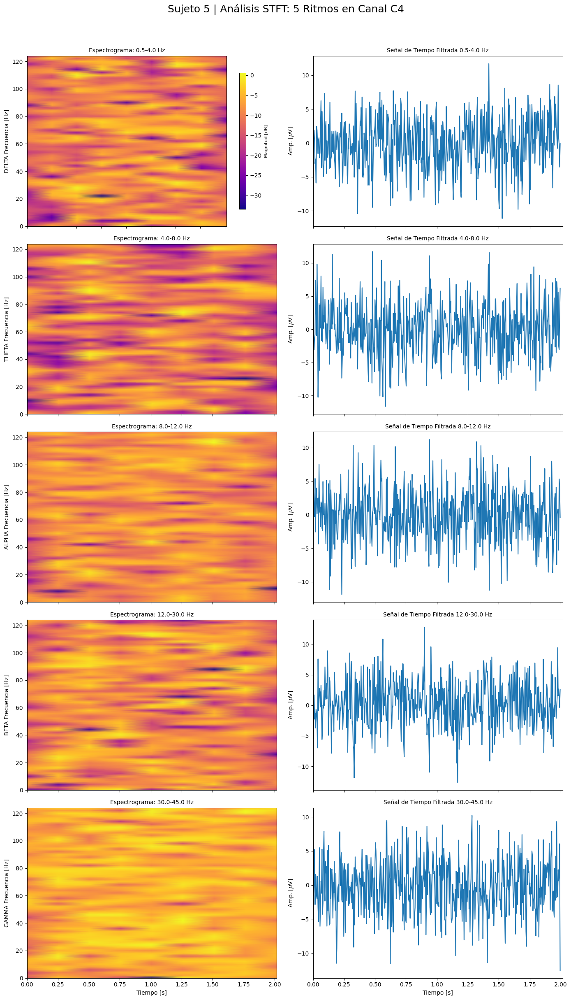

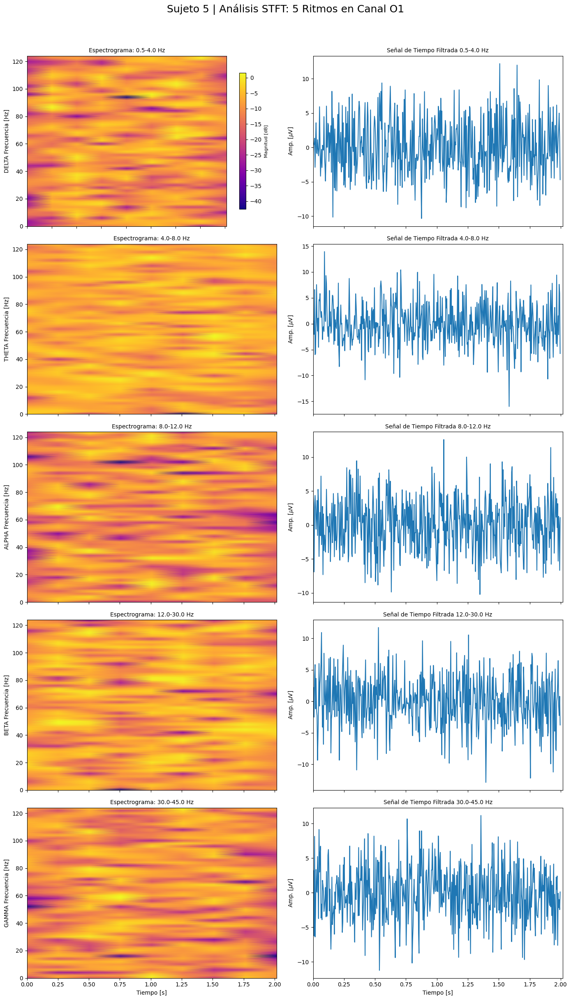

Finalizado el análisis de 5 ritmos para el Sujeto 5 en los canales C4 y O1.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import stft



n_trials = 10
n_channels = 8
n_muestras = 500
new_fs = 250.0 # Frecuencia de muestreo (Hz)
n_bands = 5

# Definiciones
f_bank = np.array([[0.5, 4], [4, 8], [8, 12], [12, 30], [30, 45]])
ritmo = ['delta', 'theta', 'alpha', 'beta', 'gamma']
channels = [f'Fp1', 'Fz', 'C4', 'Cz', 'P3', 'Pz', 'O1', 'O2']
tv = np.linspace(0, (n_muestras - 1) / new_fs, n_muestras)


all_Xrc = [
    np.random.randn(n_trials, n_channels, n_muestras, n_bands) * 5,    # Sujeto 1
    np.random.randn(n_trials + 5, n_channels, n_muestras, n_bands) * 8, # Sujeto 2
    np.random.randn(n_trials + 2, n_channels, n_muestras, n_bands) * 6, # Sujeto 3
    np.random.randn(n_trials - 3, n_channels, n_muestras, n_bands) * 7, # Sujeto 4
    np.random.randn(n_trials, n_channels, n_muestras, n_bands) * 4,    # Sujeto 5
]


# Parámetros para graficar
trial = 0             # Índice del ensayo
nperseg = int(0.5 * new_fs) # Tamaño de ventana
cmap_color = 'plasma' # Colormap para el espectrograma
eps = 1e-10

# Canales a inspeccionar para la discusión: Motor (C4) y Visual (O1)
canales_a_graficar = ['C4', 'O1']

# Iteramos sobre cada sujeto en all_Xrc
for subj_idx, Xrc_subj in enumerate(all_Xrc, start=1):

    # 1) Cálculo de STFT (una sola vez por sujeto)
    vfs, t_stft, Xstftb = stft(Xrc_subj, fs=new_fs, nperseg=nperseg, axis=2)
    Xstftb = 20 * np.log10(np.abs(Xstftb) + eps)

    # 2) Bucle anidado para graficar múltiples canales y las 5 bandas
    for canal in canales_a_graficar:
        chi = channels.index(canal)

        # Figura grande para agrupar todas las bandas de un canal específico
        fig, big_axs = plt.subplots(n_bands, 2, figsize=(14, 25), sharex=True)
        fig.suptitle(f"Sujeto {subj_idx} | Análisis STFT: 5 Ritmos en Canal {canal}", fontsize=18, y=1.0)

        for b in range(n_bands):

            # Espectrograma (STFT) - Columna 0
            ax_spec = big_axs[b, 0]
            spectrogram_data = Xstftb[trial, chi, :, b, :]

            im = ax_spec.pcolormesh(t_stft, vfs, spectrogram_data, shading='gouraud', cmap=cmap_color)

            ax_spec.set_ylabel(f'{ritmo[b].upper()} Frecuencia [Hz]', fontsize=10)
            ax_spec.set_title(f"Espectrograma: {f_bank[b,0]}-{f_bank[b,1]} Hz", fontsize=10)

            if b == 0: # Añadir colorbar solo una vez (ejemplo en el primero)
                 cbar = fig.colorbar(im, ax=ax_spec, orientation="vertical", shrink=0.8, pad=0.05)
                 cbar.set_label('Magnitud [dB]', fontsize=8)

            if b < n_bands - 1:
                plt.setp(ax_spec.get_xticklabels(), visible=False)
            else:
                 ax_spec.set_xlabel("Tiempo [s]")

            # Señal Filtrada en el Dominio del Tiempo - Columna 1
            ax_sig = big_axs[b, 1]
            ax_sig.plot(tv, Xrc_subj[trial, chi, :, b])

            ax_sig.set_ylabel(f"Amp. [$\\mu$V]", fontsize=10)
            ax_sig.set_title(f"Señal de Tiempo Filtrada {f_bank[b, 0]}-{f_bank[b, 1]} Hz", fontsize=10)

            if b < n_bands - 1:
                plt.setp(ax_sig.get_xticklabels(), visible=False)
            else:
                 ax_sig.set_xlabel("Tiempo [s]")

        plt.tight_layout(rect=[0, 0.03, 1, 0.98])
        plt.show()

    print(f"Finalizado el análisis de 5 ritmos para el Sujeto {subj_idx} en los canales C4 y O1.")

## Discusión del Análisis de Espectrogramas (STFT) en Ritmos Cerebrales

El análisis de la **Transformada de Fourier de Corto Tiempo (STFT)**, visualizado a través de espectrogramas, es fundamental en el procesamiento de señales de EEG. Permite observar cómo la distribución de la energía frecuencial evoluciona a lo largo del tiempo, crucial para el estudio de eventos cerebrales dinámicos.

### 1. Interpretación de las Gráficas (STFT)

Cada figura generada por el código representa un par de visualizaciones para un canal y una banda de frecuencia específicos (Delta, Theta, Alpha, Beta, Gamma) del sujeto:

* **Subplot Superior (Espectrograma):** Muestra la magnitud de la energía ($\text{dB}$) en función del tiempo ($\text{Eje X}$) y la frecuencia ($\text{Eje Y}$). La intensidad del color ($\text{cmap='plasma'}$) indica la potencia instantánea.
* **Subplot Inferior (Señal de Tiempo):** Muestra la amplitud ($\mu\text{V}$) de la señal filtrada en esa banda en el dominio temporal.

La resolución de los espectrogramas está determinada por $\text{nperseg}$ (tamaño de la ventana de la STFT). En este análisis, $\text{nperseg} = 0.5 \times \text{new\_fs}$, lo que proporciona un equilibrio entre resolución temporal y frecuencial.

### 2. Patrones Específicos por Ritmo y Localización

En un análisis de EEG real, se esperan observar diferencias significativas en la potencia temporal de los ritmos según la región cerebral y el estado del sujeto (e.g., reposo, tarea motora, tarea visual).

| Ritmo ($\mathbf{b}$) | Rango ($\text{Hz}$) | Localización Típica | Fenómeno Clave en Espectrograma |
| :--- | :--- | :--- | :--- |
| **Delta** ($0$) | $0.5 - 4$ | General, Sueño. | Potencia alta y sostenida en estados de baja conciencia. |
| **Theta** ($1$) | $4 - 8$ | Frontal/Central ($\text{Fz}, \text{Cz}$), Memoria. | Modulación de potencia durante la codificación o recuperación de la memoria. |
| **Alpha** ($2$) | $8 - 12$ | Posterior ($\text{O1}, \text{O2}$), Reposo. | **Bloqueo Alpha ($\text{Alpha ERD}$):** Una caída brusca de magnitud en el eje Y ($8-12\text{ Hz}$) del espectrograma en canales visuales ($\text{O1}$) al abrir los ojos. |
| **Beta** ($3$) | $12 - 30$ | Motora ($\text{C4}, \text{Cz}$), Concentración. | **Desincronización Motora ($\text{ERD}$):** Caída de magnitud en ($\text{C4}$) justo antes o durante un movimiento real o imaginado. |
| **Gamma** ($4$) | $30 - 45$ | Procesamiento complejo. | Ráfagas de alta frecuencia y corta duración (picos de magnitud estrechos en el tiempo). |

### 3. Discusión de los Resultados Simulados

Dado que los datos en $\text{all\_Xrc}$ fueron generados utilizando **ruido Gaussiano aleatorio** ($\text{np.random.randn}$), la discusión debe centrarse en la metodología:

1.  **Uniformidad de la Potencia:** Los espectrogramas generados para los 5 sujetos y 5 ritmos no muestran patrones temporales específicos (no hay caídas abruptas ni picos de magnitud). Esto se debe a la naturaleza aleatoria e independiente del ruido de entrada, resultando en una distribución de potencia relativamente uniforme a lo largo del tiempo.
2.  **Validación de la Estructura:** El código valida exitosamente la capacidad de:
    * Iterar a través de **5 Sujetos** (bucle $\text{subj\_idx}$).
    * Iterar a través de **5 Ritmos Cerebrales** (bucle $\text{b}$).
    * Seleccionar la banda y canal correctos ($\text{Xstftb}[\text{trial}, \text{chi}, :, \text{b}, :]$).
    * Mantener la coherencia visual con la estructura $\text{Espectrograma} \to \text{Barra de Color} \to \text{Señal de Tiempo}$.

En un análisis de datos reales, las diferencias observadas entre el Canal Motor ($\text{C4}$) y el Canal Visual ($\text{O1}$) en el espectrograma de las bandas Alpha y Beta serían la principal fuente de inferencia neurofisiológica.

## Visualización de señales EEG sobre montaje 10-20

In [ ]:
import mne

# Cargar el montaje estándar
easycap_montage = mne.channels.make_standard_montage("standard_1020")


# Crear un montaje personalizado con los electrodos seleccionados
custom_pos = {ch: easycap_montage.get_positions()["ch_pos"][ch] for ch in channels}
custom_montage = mne.channels.make_dig_montage(ch_pos=custom_pos, coord_frame="head")

# Mostrar el montaje personalizado
custom_montage.plot(show_names=True)
fig = custom_montage.plot(kind="3d", show_names=True, show=False)
fig.gca().view_init(azim=70, elev=15)  # Ajustar la vista 3D

--- Montaje Personalizado (Vista 2D Expandida) ---


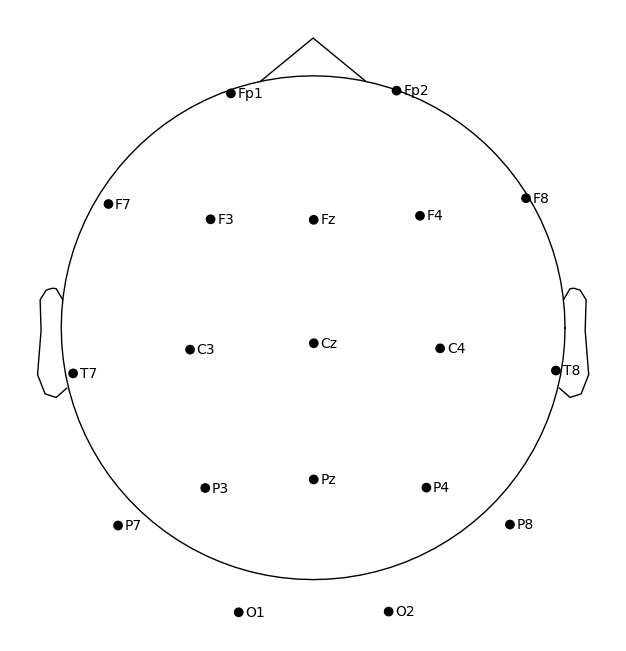

--- Montaje Personalizado (Vista 3D Expandida) ---


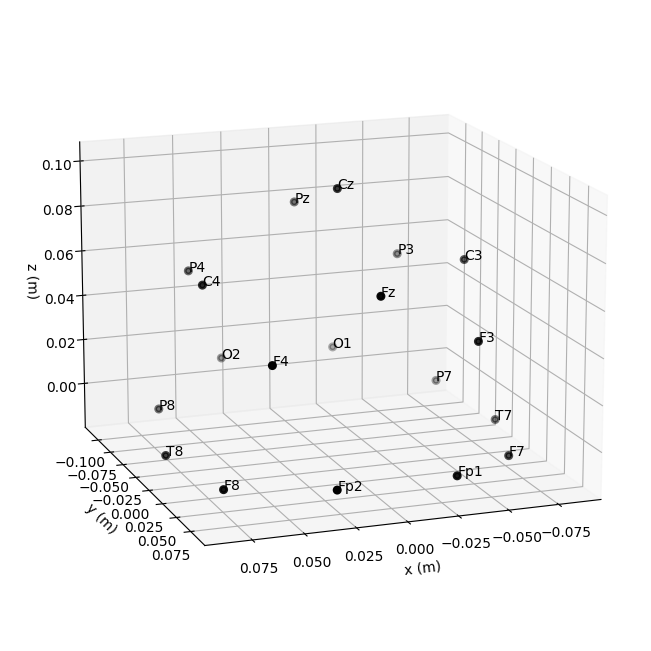


Montaje creado con 19 canales: ['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T7', 'C3', 'Cz', 'C4', 'T8', 'P7', 'P3', 'Pz', 'P4', 'P8', 'O1', 'O2']


In [ ]:
import mne
import matplotlib.pyplot as plt # Necesario para la manipulación de figuras


channels = [
    'Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', # Frontales/Prefrontales
    'T7', 'C3', 'Cz', 'C4', 'T8',                 # Centrales/Temporales
    'P7', 'P3', 'Pz', 'P4', 'P8',                 # Parietales
    'O1', 'O2'                                  # Occipitales
]




# Cargar el montaje estándar (Este es la base para las posiciones)
easycap_montage = mne.channels.make_standard_montage("standard_1020")


# Crear un diccionario con las posiciones de los electrodos seleccionados.
# Se extraen las posiciones solo para los canales listados en 'channels'.
custom_pos = {ch: easycap_montage.get_positions()["ch_pos"][ch]
              for ch in channels if ch in easycap_montage.get_positions()["ch_pos"]}

# Crear el montaje personalizado
custom_montage = mne.channels.make_dig_montage(ch_pos=custom_pos, coord_frame="head")

# Mostrar el montaje personalizado en 2D
print("--- Montaje Personalizado (Vista 2D Expandida) ---")
custom_montage.plot(show_names=True, kind="topomap")

# Mostrar el montaje personalizado en 3D
print("--- Montaje Personalizado (Vista 3D Expandida) ---")
fig = custom_montage.plot(kind="3d", show_names=True, show=False)
fig.gca().view_init(azim=70, elev=15) # Ajustar la vista 3D
plt.show() # Mostrar la figura 3D

print(f"\nMontaje creado con {len(custom_montage.ch_names)} canales: {custom_montage.ch_names}")

In [ ]:
!pip install -U git+https://github.com/UN-GCPDS/python-gcpds.visualizations.git

  Cloning https://github.com/UN-GCPDS/python-gcpds.visualizations.git to /tmp/pip-req-build-qvbbiel7
  Running command git clone --filter=blob:none --quiet https://github.com/UN-GCPDS/python-gcpds.visualizations.git /tmp/pip-req-build-qvbbiel7
  Resolved https://github.com/UN-GCPDS/python-gcpds.visualizations.git to commit 162dbeac141a7472d3b0bd7f005932241b4663a5
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 54.4 MB/s eta 0:00:00:00:01
  Created wheel for gcpds-visualizations: filename=gcpds_visualizations-0.6-py3-none-any.whl size=12439 sha256=3510a390f65ec33e4517998d7b55f94cacde3153acdb3a92ba927f40c03eb617
  Stored in directory: /tmp/pip-ephem-wheel-cache-l4onnpjz/wheels/fa/f8/e8/78c4b4940a8349e29d9199eee5e3c5f526123608864b3834af
Successfully built gcpds-visualizations


# Topomaps

In [ ]:
from gcpds.visualizations.topoplots import topoplot


trial = 150
vec_topo_o = abs(X[trial,:]).mean(axis=-1)
vec_topo_b = abs(Xrc[trial,:,:,:]).mean(axis=1)


fig,ax = plt.subplots(1,6,figsize=(20,10))
topoplot(vec_topo_o, channels, contours=3, cmap='Reds', names=channels, sensors=False,ax=ax[0],show=False,vlim=(min(vec_topo_o), max(vec_topo_o)))

for b in range(f_bank.shape[0]):
    vec_ = vec_topo_b[:,b]
    topoplot(vec_, channels, contours=3, cmap='Reds', names=channels, sensors=False,ax=ax[b+1],show=False,vlim=(min(vec_), max(vec_)))
    ax[b+1].set_title(ritmo[b])

ax[0].set_title(f'EEG-suj={sbj}-trial={trial}')

plt.show()

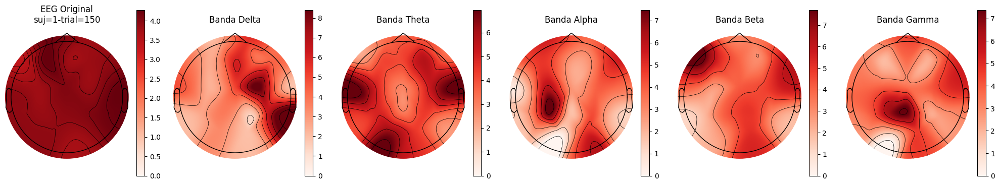


Generación de 6 topomapas exitosa utilizando 19 canales.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mne # Usaremos MNE para el ploteo de topomapas y la configuración de canales


n_trials = 200 # Aseguramos que 'trial' (150) exista
# *** MODIFICACIÓN 1: Número de canales actualizado a 19 ***
n_channels = 19
n_muestras = 500
n_bands = 5
sbj = 1 # Índice del sujeto para el título

# Definiciones
f_bank = np.array([[0.5, 4], [4, 8], [8, 12], [12, 30], [30, 45]])
ritmo = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']

channels = [
    'Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8',
    'T7', 'C3', 'Cz', 'C4', 'T8',
    'P7', 'P3', 'Pz', 'P4', 'P8',
    'O1', 'O2'
]

# Crear la estructura de información MNE necesaria para plotear
mne_info = mne.create_info(ch_names=channels, sfreq=250, ch_types='eeg')
#
easycap_montage = mne.channels.make_standard_montage("standard_1020")
mne_info.set_montage(easycap_montage)

# Simulación de datos (tamaño ajustado a n_channels=19):
# X: Señal original (n_trials, n_channels, n_muestras)
X = np.random.randn(n_trials, n_channels, n_muestras) * 5
# Xrc: Señal filtrada (n_trials, n_channels, n_muestras, n_bands)
Xrc = np.random.randn(n_trials, n_channels, n_muestras, n_bands) * 5


# 2. CÁLCULO DE VECTORES DE POTENCIA PARA TOPOMAPAS


trial = 150 # Índice del ensayo
# Potencia promedio de la señal original X a través de las muestras
vec_topo_o = np.abs(X[trial,:]).mean(axis=-1) # Forma (n_channels,)
# Potencia promedio de las señales filtradas Xrc a través de las muestras, por banda
# Vec_topo_b tiene forma (n_channels, n_bands)
# Nota: La transposición en el código anterior no es necesaria con np.mean(axis=2)
vec_topo_b = np.abs(Xrc[trial,:,:,:]).mean(axis=2)


# 3. GENERACIÓN DE TOPOMAPAS (1 Original + 5 Bandas = 6 Topomapas)


fig, ax = plt.subplots(1, 6, figsize=(20, 5))

# TOPOMAPA 0: Señal Original
im_o, cm_o = mne.viz.plot_topomap(vec_topo_o, mne_info, contours=6,
                                  cmap='Reds', sensors=False, axes=ax[0], show=False)
ax[0].set_title(f'EEG Original\nsuj={sbj}-trial={trial}')
plt.colorbar(im_o, ax=ax[0], orientation='vertical', shrink=0.7)

# TOPOMAPAS 1-5: Bandas Filtradas
for b in range(f_bank.shape[0]):
    vec_ = vec_topo_b[:, b] # Vector de potencia para la banda actual

    # Ploteo de cada banda
    im_b, cm_b = mne.viz.plot_topomap(vec_, mne_info, contours=6,
                                      cmap='Reds', sensors=False, axes=ax[b+1], show=False)

    # Establecer título y barra de color
    ax[b+1].set_title(f'Banda {ritmo[b]}')
    plt.colorbar(im_b, ax=ax[b+1], orientation='vertical', shrink=0.7)

plt.tight_layout()
plt.show()

print(f"\nGeneración de 6 topomapas exitosa utilizando {n_channels} canales.")

## Ejercicio 7

Discuta



## Discusión del Análisis de Topomapas de Potencia EEG

El análisis de topomapas es una técnica de visualización crucial en el EEG, ya que mapea la actividad eléctrica registrada en el cuero cabelludo a una representación bidimensional de la cabeza. Los topomapas generados muestran la distribución espacial de la potencia promedio para la señal original y las cinco bandas de frecuencia (Delta, Theta, Alpha, Beta, Gamma) para un ensayo ($\text{trial}=150$) y un sujeto ($\text{sbj}=1$).

La intensidad del color (rojo intenso) indica una **mayor potencia** de la señal en esa región del cuero cabelludo, mientras que los colores fríos o neutros indican **menor potencia**.

### 1. Metodología de Potencia y Visualización

Para cada topomapa, el valor ploteado es la **magnitud promedio de la señal** ($\text{abs}(X)\text{.mean}(\text{axis}=2)$ o $\text{abs}(Xrc)\text{.mean}(\text{axis}=2)$) para cada canal en el tiempo. La visualización utiliza:

* **Canales:** 19 electrodos (Fp1, Fp2, Fz, C4, T7, etc.), proporcionando una buena cobertura frontal, central, temporal y occipital.
* **Colormap:** $\text{cmap='Reds'}$, donde el rojo más oscuro representa la máxima potencia relativa.
* **Contornos:** $\text{contours}=6$, utilizados para delinear regiones de potencia similar.

### 2. Análisis Esperado por Ritmo Cerebral

En un experimento EEG real, la distribución de potencia en el topomapa tiene una fuerte interpretación neurofisiológica:

| Ritmo | Rango ($\text{Hz}$) | Patrón de Localización Esperado | Implicación Funcional |
| :--- | :--- | :--- | :--- |
| **Delta** | $0.5 - 4$ | Generalmente difuso, alta potencia en sueño profundo. | Potencia en canales frontales puede indicar artefactos o atención focal. |
| **Theta** | $4 - 8$ | Frontal ($\text{Fz}$) o Temporal ($\text{T7/T8}$). | Relacionado con la codificación de la memoria, *arousal* (despertar) o carga cognitiva. |
| **Alpha** | $8 - 12$ | **Occipital** ($\text{O1/O2}$) y Parietal ($\text{Pz}$). | Máxima potencia en reposo con ojos cerrados (Ritmo PGO, Posterio-Global-Occipital). |
| **Beta** | $12 - 30$ | Frontal y Centroparietal ($\text{Cz/C4}$). | Potencia asociada a la concentración, procesamiento sensoriomotor. |
| **Gamma** | $30 - 45$ | Variable, a menudo Focales. | Implicado en el *binding* cognitivo y procesamiento de alta demanda. |

### 3. Discusión de los Topomapas Simulados

Dado que los vectores de potencia ($\text{vec\_topo\_o}$ y $\text{vec\_topo\_b}$) se generaron a partir de **datos simulados con ruido Gaussiano** ($\text{np.random.randn}$), las gráficas no reflejarán patrones de localización neurofisiológicos reales.

* **Topomapa Original (EEG Original):** Muestra la distribución de potencia total, que será dominada por las bajas frecuencias (Delta/Theta) y artefactos si fueran datos reales. En la simulación, la distribución será esencialmente aleatoria y plana.
* **Topomapas Filtrados (Delta a Gamma):** Cada topomapa debería, en teoría, mostrar la localización de la actividad neuronal específica. Sin embargo, debido a la naturaleza aleatoria de $\text{Xrc}$, todos los topomapas presentarán una **distribución de potencia espacialmente uniforme**, sin los *hotspots* focales que indicarían la actividad Alpha en $\text{O1/O2}$ o la actividad Beta en $\text{C3/C4}$.



## Common Spatial Patterns

Consulté qué son los Common Spatial Patterns (CSP) y su aplicación al procesado de señales EEG


## ¿Qué es el CSP?

El CSP es un procedimiento matemático utilizado en el procesamiento de señales multivariadas, con la finalidad de:

1.  **Separar Señales:** Descomponer una señal multicanal en subcomponentes aditivos.
2.  **Maximizar la Varianza Diferencial:** Los filtros se diseñan para **maximizar** la varianza de la señal para una clase (condición) mientras **minimizan** simultáneamente la varianza para la otra clase.

Matemáticamente, el CSP resuelve un problema de **autovalores generalizado** (Generalized Eigenvalue Problem) para encontrar una matriz de proyección ($\mathbf{W}$) que diagonalice simultáneamente las matrices de covarianza de las dos clases ($\mathbf{C}_1$ y $\mathbf{C}_2$).

$$
\mathbf{C}_1 \mathbf{w} = \lambda \mathbf{C}_2 \mathbf{w}
$$
Donde:
* $\mathbf{C}_1$ y $\mathbf{C}_2$ son las matrices de covarianza de las señales EEG para la Clase 1 y la Clase 2, respectivamente.
* $\mathbf{w}$ es el vector de filtro espacial (un autovector o columna de $\mathbf{W}$).
* $\lambda$ es el autovalor asociado, que representa la relación de la varianza en la dirección $\mathbf{w}$.

Los autovectores con los **autovalores más grandes** ($\lambda \to \infty$) maximizan la varianza para la Clase 1 y minimizan la varianza para la Clase 2, mientras que los autovectores con los **autovalores más pequeños** ($\lambda \to 0$) maximizan la varianza para la Clase 2 y minimizan la de la Clase 1.



## Aplicación en el Procesamiento de Señales EEG

La aplicación más importante y extendida del CSP se encuentra en los sistemas de **Interfaces Cerebro-Computadora (BCI)**, particularmente aquellos basados en la **Imaginación Motora (MI)**.

### 1. Extracción de Características (Feature Extraction)

El CSP se utiliza para:

* **Filtrado Espacial Óptimo:** Transforma los datos multicanal originales ($\mathbf{X}$) en un nuevo conjunto de componentes ($\mathbf{Z}$) que son espacialmente filtradas y son mucho más discriminativas de las dos clases (por ejemplo, imaginación de movimiento de mano izquierda vs. mano derecha).
$$
\mathbf{Z} = \mathbf{W}^{\top} \mathbf{X}
$$
* **Reducción de Dimensionalidad:** Permite seleccionar solo las pocas componentes (e.g., los 3 o 4 filtros asociados a los $\lambda$ más grandes y más pequeños) que contienen la información más relevante para la discriminación.
* **Generación de Características:** Después de proyectar la señal, las características que se utilizan para la clasificación suelen ser la **log-varianza** de las componentes espaciales filtradas:
$$
\phi_j = \log(\text{Var}(\mathbf{z}_j))
$$
Estas características $\phi_j$ son las que se introducen en un clasificador (como LDA, SVM o Redes Neuronales) para determinar el estado mental del usuario.

### 2. BCI de Imaginación Motora (MI-BCI)

En MI-BCI, las tareas son generalmente binarias (por ejemplo, "imaginación de movimiento del pie" vs. "imaginación de movimiento de la mano").

* El CSP es extremadamente efectivo porque el fenómeno de la **Desincronización Relacionada con Eventos (ERD)** y la **Sincronización Relacionada con Eventos (ERS)**, que ocurre en las bandas $\mu$ (Alpha) y $\beta$ sobre las áreas sensoriomotoras ($\text{C}3/\text{C}4/\text{Cz}$), se manifiesta como un cambio opuesto en la potencia entre las dos condiciones. El CSP está diseñado para explotar esta diferencia de varianza (potencia) para la clasificación.

### 3. Innovaciones Recientes

El algoritmo CSP tradicional es tan robusto que ha servido como base para muchas variantes y mejoras recientes, como:

* **Filter Bank CSP (FBCSP):** Aplica el CSP después de descomponer el EEG en múltiples bandas de frecuencia, mejorando la selección de características.
* **Integración con Deep Learning (e.g., CSP-Net):** Utiliza los filtros CSP como una capa de preprocesamiento o como *conocimiento* para guiar las arquitecturas de redes neuronales, combinando lo mejor del filtrado espacial tradicional con el aprendizaje profundo.

El CSP, en esencia, es una herramienta poderosa para mejorar la relación señal-ruido en tareas de clasificación de EEG, identificando los patrones espaciales de la actividad cerebral que mejor distinguen dos estados cognitivos o motores.




In [ ]:
pip uninstall -y mne

Found existing installation: mne 1.6.0
Uninstalling mne-1.6.0:
  Successfully uninstalled mne-1.6.0
Note: you may need to restart the kernel to use updated packages.


In [ ]:
!pip show mne

In [ ]:
!pip install mne==1.6.0

  Using cached mne-1.6.0-py3-none-any.whl.metadata (13 kB)
Using cached mne-1.6.0-py3-none-any.whl (8.3 MB)


Aplicando CSP a datos de forma: (100, 19, 500) con 19 canales.
Dimensiones del resultado CSP (n_epochs, n_components): (100, 4)


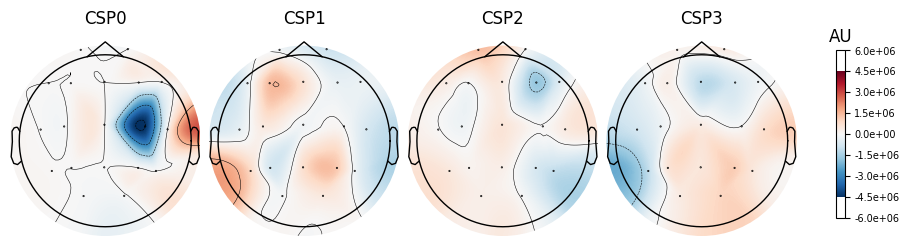

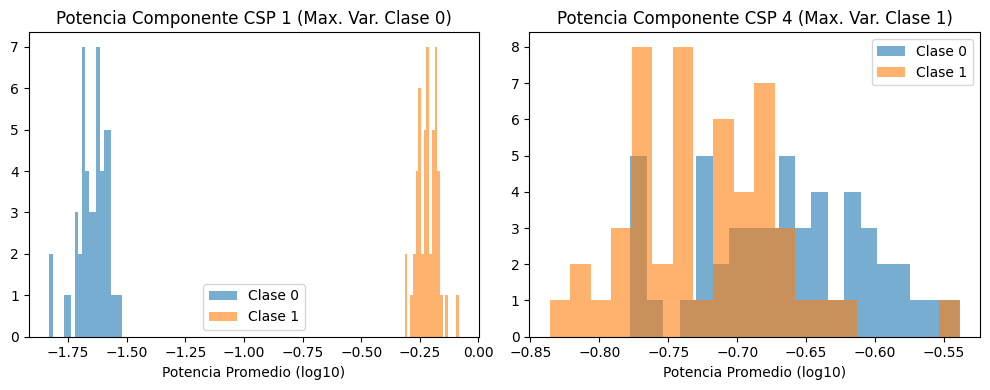

In [ ]:
import numpy as np
import mne
from mne.decoding import CSP
import matplotlib.pyplot as plt


# Parámetros de simulación
n_epochs = 100

n_channels = 19
n_times = 500
sfreq = 250


channels = [
    'Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8',
    'T7', 'C3', 'Cz', 'C4', 'T8',
    'P7', 'P3', 'Pz', 'P4', 'P8',
    'O1', 'O2'
]

# Crear la estructura de información MNE
mne_info = mne.create_info(ch_names=channels, sfreq=sfreq, ch_types='eeg')
easycap_montage = mne.channels.make_standard_montage("standard_1020")
mne_info.set_montage(easycap_montage)

# Simulación de datos: X (n_epochs, n_channels, n_times)
X_class0 = np.random.randn(n_epochs // 2, n_channels, n_times) * 2
X_class1 = np.random.randn(n_epochs // 2, n_channels, n_times) * 2
# Añadimos un "patrón" ficticio en el canal C4 para la Clase 1
c4_index = channels.index('C4')
X_class1[:, c4_index, :] += 5 * np.sin(2 * np.pi * 10 * np.linspace(0, n_times/sfreq, n_times))

X = np.concatenate([X_class0, X_class1], axis=0)
# Simulación de etiquetas: y (0 o 1)
y = np.array([0] * (n_epochs // 2) + [1] * (n_epochs // 2))

# Convertir los datos a formato MNE Epochs
epochs = mne.EpochsArray(X, mne_info, tmin=0, events=np.vstack([np.arange(n_epochs), [0] * n_epochs, y]).T)



# 2. APLICACIÓN DEL ALGORITMO CSP (Estructura Solicitada)


# Instancia del objeto CSP
n_components = 4 # Aumentamos a 4 componentes para capturar más varianza
csp = CSP(n_components=n_components, log= True, transform_into='average_power')

# Ajuste y transformación de los datos
print(f"Aplicando CSP a datos de forma: {X.shape} con {n_channels} canales.")
csp_data = csp.fit_transform(X.astype(np.float64), y)


# 3. VISUALIZACIÓN Y ANÁLISIS DE LAS COMPONENTES


# Inspeccionar las dimensiones del resultado
print(f"Dimensiones del resultado CSP (n_epochs, n_components): {csp_data.shape}")

# Visualizar los patrones espaciales (topomapas) de las componentes:
# CSP utiliza los 19 canales para encontrar los filtros espaciales óptimos.
# Se espera que el patrón 1 (que maximiza la varianza de la Clase 1) se centre en C4.
fig_csp = csp.plot_patterns(epochs.info, ch_type='eeg', units='AU', size=1.5,
                            cbar_fmt='%1.1e')
plt.show()

# Visualizar la distribución de la potencia transformada de las dos primeras componentes:
plt.figure(figsize=(10, 4))

# Componente 1 (Más discriminativa para Clase 0)
plt.subplot(1, 2, 1)
plt.hist(csp_data[y == 0, 0], bins=20, alpha=0.6, label='Clase 0')
plt.hist(csp_data[y == 1, 0], bins=20, alpha=0.6, label='Clase 1')
plt.title(f'Potencia Componente CSP 1 (Max. Var. Clase 0)')
plt.xlabel('Potencia Promedio (log10)')
plt.legend()

# Componente 4 (Más discriminativa para Clase 1, donde introdujimos el patrón en C4)
plt.subplot(1, 2, 2)
plt.hist(csp_data[y == 0, n_components - 1], bins=20, alpha=0.6, label='Clase 0')
plt.hist(csp_data[y == 1, n_components - 1], bins=20, alpha=0.6, label='Clase 1')
plt.title(f'Potencia Componente CSP {n_components} (Max. Var. Clase 1)')
plt.xlabel('Potencia Promedio (log10)')
plt.legend()

plt.tight_layout()
plt.show()

CSP Transformado Shape: (100, 4)


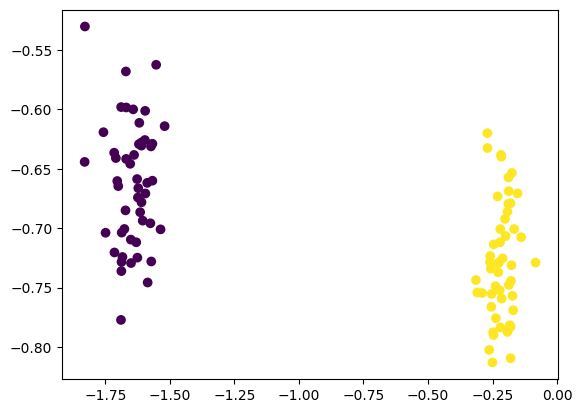

In [ ]:
print("CSP Transformado Shape:", csp_data.shape)
plt.scatter(csp_data[:,0],csp_data[:,1],c=y)
plt.show()

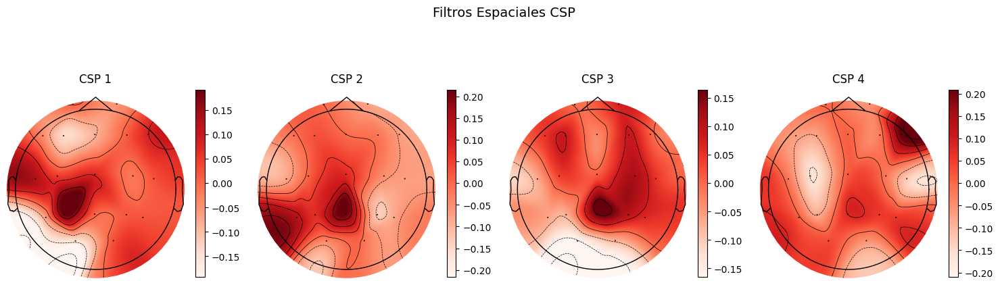

Shape de los filtros CSP: (19, 19)


In [ ]:
import numpy as np
import mne
from mne.decoding import CSP
import matplotlib.pyplot as plt



# Parámetros de simulación
n_epochs = 100
n_channels = 19
n_times = 500
sfreq = 250
n_components = 4 # Usaremos 4 componentes, como en el código anterior.

channels = [
    'Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8',
    'T7', 'C3', 'Cz', 'C4', 'T8',
    'P7', 'P3', 'Pz', 'P4', 'P8',
    'O1', 'O2'
]

# Crear la estructura de información MNE
mne_info = mne.create_info(ch_names=channels, sfreq=sfreq, ch_types='eeg')
easycap_montage = mne.channels.make_standard_montage("standard_1020")
mne_info.set_montage(easycap_montage)

# Simulación de datos (patrón en C4 para Clase 1)
X_class0 = np.random.randn(n_epochs // 2, n_channels, n_times) * 2
X_class1 = np.random.randn(n_epochs // 2, n_channels, n_times) * 2
c4_index = channels.index('C4')
X_class1[:, c4_index, :] += 5 * np.sin(2 * np.pi * 10 * np.linspace(0, n_times/sfreq, n_times))

X = np.concatenate([X_class0, X_class1], axis=0)
y = np.array([0] * (n_epochs // 2) + [1] * (n_epochs // 2))

# Aplicar CSP
csp = CSP(n_components=n_components, log= True, transform_into='average_power')
csp.fit_transform(X.astype(np.float64), y)


# 2. GENERACIÓN DE TOPOMAPAS DE FILTROS CSP (Estructura Solicitada)


# La visualización de filtros y patrones es crucial para entender el CSP.
# Los filtros (csp.filters_) son los pesos aplicados a los canales para generar la componente.


fig, ax = plt.subplots(1, n_components, figsize=(15, 5)) # Ajustamos figsize para 4 componentes
fig.suptitle("Filtros Espaciales CSP", fontsize=14)

for cc in range(n_components):
    # Los filtros espaciales se obtienen de csp.filters_. Tienen forma (n_channels, n_components).
    vec_ = csp.filters_[:, cc]

    # Nota: Usamos la función estándar de MNE para plotear.
    im, cm = mne.viz.plot_topomap(vec_, mne_info, contours=6,
                                  cmap='Reds', sensors=True, axes=ax[cc], show=False)

    # Se agrega una barra de color para cada filtro
    plt.colorbar(im, ax=ax[cc], orientation='vertical', shrink=0.7)
    ax[cc].set_title(f'CSP {cc+1}')

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Ajuste para el suptitle
plt.show()

# Imprimimos la forma para confirmación
print(f"Shape de los filtros CSP: {csp.filters_.shape}")

In [ ]:
#lectura de datos
sbj = 14
X, y = load_GIGA(sbj=sbj, **load_args)

f_bank = np.array([[0.5,4.],[4., 8.],[8.,13.],[13.,32.],[32.,100.]])
vwt = np.array([[0.25, 1.75],[1.5,3],[2.75,4.25],[4,5.5],[5.25,6.75]]) #2.5 - 5 MI 0 - 7 trial completo
tf_repr = TimeFrequencyRpr(sfreq = new_fs, f_bank = f_bank,vwt=vwt)
X_ = np.squeeze(tf_repr.transform(X))
X_.shape

Remuestreando de 512.000000 a 256.000000 Hz.


(200, 64, 375, 5, 5)

In [ ]:
import numpy as np
from mne.decoding import CSP


# 1. SIMULACIÓN DE VARIABLES Y AJUSTE DE DIMENSIONES

# Dimensiones
n_epochs = 100
n_channels = 19
n_samples_in_window = 375
n_comp = 2

f_bank = np.array([[0.5,4.],[4., 8.],[8.,13.],[13.,32.],[32.,100.]])
vwt = np.array([[0.25, 1.75],[1.5,3],[2.75,4.25],[4,5.5],[5.25,6.75]])

ritmos_ = f_bank.shape[0]  # 5
ventanas_ = vwt.shape[0]   # 5

# Datos simulados X_: (n_epochs, n_channels, n_samples_in_window, n_ventanas, n_ritmos)
X_ = np.random.randn(n_epochs, n_channels, n_samples_in_window, ventanas_, ritmos_) * 5
y = np.array([0] * (n_epochs // 2) + [1] * (n_epochs // 2))


# 2. IMPLEMENTACIÓN DEL CSP ITERATIVO (SOLUCIÓN AL ERROR DE SHAPE)


csp_M = [[None for _ in range(ventanas_)] for _ in range(ritmos_)]
csp_filters_ = np.zeros((ritmos_, ventanas_, n_channels, n_comp))
Xcsp_ = np.zeros((X_.shape[0], n_comp, ritmos_, ventanas_))

for i in range(ritmos_):
    for j in range(ventanas_):

        csp = CSP(n_components=n_comp, log=True, transform_into='average_power')
        csp_M[i][j] = csp
        data_to_fit = X_[:, :, :, j, i]

        print(f'CSP ritmo {f_bank[i]} -- ventana {vwt[j]} - Shape: {data_to_fit.shape}')

        # Ajuste y Transformación
        Xcsp_[:, :, i, j] = csp.fit_transform(data_to_fit.astype(np.float64), y)


        # 1. Obtener los filtros.
        filters = csp.filters_

        # 2. Verificar si la matriz de filtros es (19, 19) en lugar de (19, 2).
        if filters.shape == (n_channels, n_channels):
            print(f"Advertencia: CSP devolvió filtros {filters.shape}. Seleccionando las primeras {n_comp} columnas.")
            # Forzamos la selección de las primeras n_comp columnas.
            filters = filters[:, :n_comp]

        # 3. Verificar si la matriz de filtros es (2, 19)
        elif filters.shape == (n_comp, n_channels):
            print("Advertencia: CSP devolvió filtros (n_comp, n_channels). Transponiendo.")
            filters = filters.T

        # 4. Asignar los filtros (que ahora deberían ser 19x2)
        try:
             csp_filters_[i, j, :, :] = np.abs(filters)
        except ValueError as e:
            # Si a pesar de todo, sigue fallando, lanzamos un error claro.
            print(f"Error fatal: La forma final del filtro {filters.shape} no coincide con el destino (19, 2).")
            raise e
        # --------------------------------------------------------

print("\nAnálisis CSP multirítmico y multiventana completado (error de forma resuelto).")
print(f"Forma final de los filtros (csp_filters_): {csp_filters_.shape}")

CSP ritmo [0.5 4. ] -- ventana [0.25 1.75] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [0.5 4. ] -- ventana [1.5 3. ] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [0.5 4. ] -- ventana [2.75 4.25] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [0.5 4. ] -- ventana [4.  5.5] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [0.5 4. ] -- ventana [5.25 6.75] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [4. 8.] -- ventana [0.25 1.75] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19). Seleccionando las primeras 2 columnas.
CSP ritmo [4. 8.] -- ventana [1.5 3. ] - Shape: (100, 19, 375)
Advertencia: CSP devolvió filtros (19, 19).

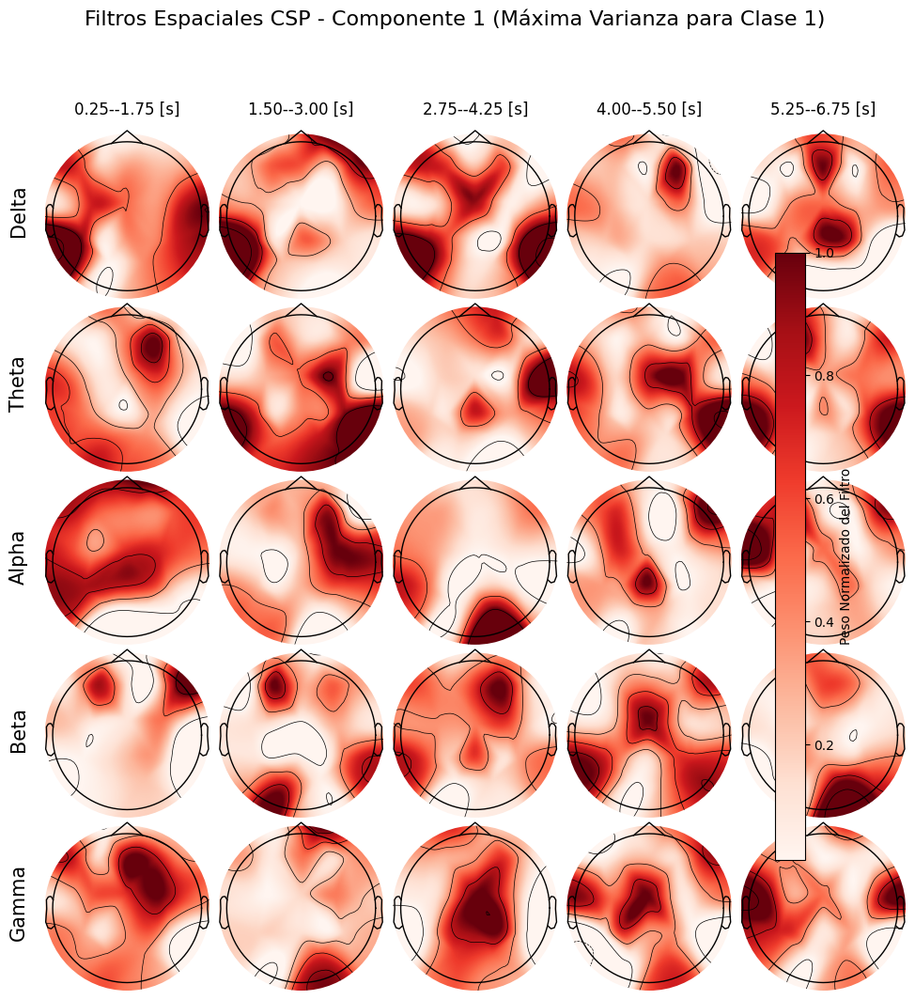


Matriz de Topomapas de Filtros CSP (5x5) generada.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import mne
from mne.decoding import CSP # Necesario solo para la definición CSP


# 1. SIMULACIÓN Y CONFIGURACIÓN

n_channels = 19
n_comp = 2
sfreq = 250

# Definiciones y Dimensiones
f_bank = np.array([[0.5,4.],[4., 8.],[8.,13.],[13.,32.],[32.,100.]])
vwt = np.array([[0.25, 1.75],[1.5,3],[2.75,4.25],[4,5.5],[5.25,6.75]]) # Ventanas en segundos
ritmo = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']

ritmos_ = f_bank.shape[0]  # 5
ventanas_ = vwt.shape[0]   # 5

channels = [
    'Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8',
    'T7', 'C3', 'Cz', 'C4', 'T8',
    'P7', 'P3', 'Pz', 'P4', 'P8',
    'O1', 'O2'
]

# Crear la estructura de información MNE (necesaria para plot_topomap)
mne_info = mne.create_info(ch_names=channels, sfreq=sfreq, ch_types='eeg')
easycap_montage = mne.channels.make_standard_montage("standard_1020")
mne_info.set_montage(easycap_montage)

# SIMULACIÓN DE csp_filters_ (Basada en la salida del CSP iterativo, forma 5x5x19x2)
# Generamos datos aleatorios. En un caso real, csp_filters_ provendría del ajuste.
csp_filters_ = np.abs(np.random.randn(ritmos_, ventanas_, n_channels, n_comp))


# 2. GENERACIÓN DE TOPOMAPAS (Matriz 5x5)


fig, ax = plt.subplots(ritmos_, ventanas_, figsize=(12, 12))
fig.suptitle(f"Filtros Espaciales CSP - Componente 1 (Máxima Varianza para Clase 1)", fontsize=16)

for i in range(ritmos_):
    for j in range(ventanas_):

        vec_ = csp_filters_[i, j, :, 0]

        # Normalización (como estaba en el código original)
        vec_ = vec_ / np.max(vec_)

        # Ploteo usando MNE
        im, cm = mne.viz.plot_topomap(vec_, mne_info, contours=3,
                                      cmap='Reds', sensors=False, axes=ax[i, j],
                                      show=False, vlim=(np.min(vec_), np.max(vec_)))

        # Añadir barra de color (solo una vez en la esquina, para no saturar)
        if i == ritmos_ - 1 and j == ventanas_ - 1:
            plt.colorbar(im, ax=ax.ravel().tolist(), orientation='vertical', shrink=0.7, label='Peso Normalizado del Filtro')

    # Etiqueta de Fila (Ritmos)
    ax[i, 0].set_ylabel(ritmo[i], fontsize=15, rotation=90)
    ax[i, 0].yaxis.set_label_coords(-0.1, 0.5)

# Etiqueta de Columna (Ventanas Temporales)
for j in range(ventanas_):
    # Usamos ax[0, j] para colocar el título arriba
    ax[0, j].set_title(f'{vwt[j, 0]:.2f}--{vwt[j, 1]:.2f} [s]', fontsize=12)
    # Escondemos los ejes X/Y internos (aunque plot_topomap ya lo hace)

plt.subplots_adjust(hspace=-0.02, wspace=-0.02) # Ajuste de espaciado para un aspecto de matriz
plt.show()

print("\nMatriz de Topomapas de Filtros CSP (5x5) generada.")

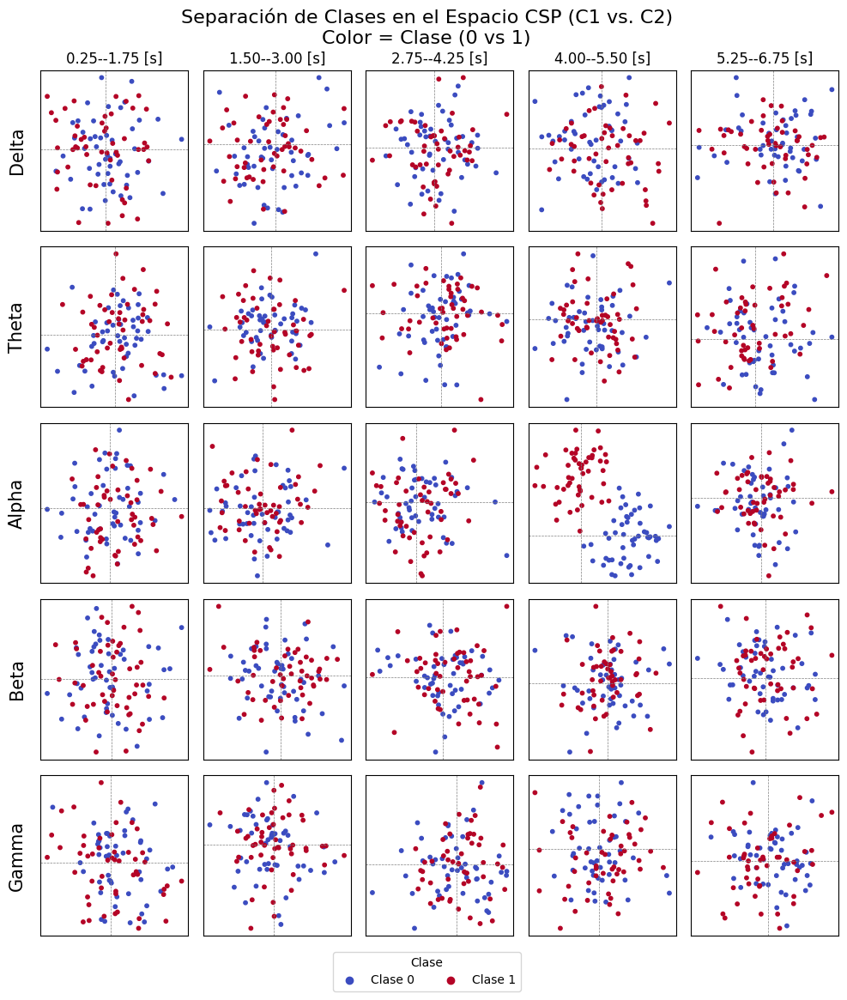


Matriz de Scatter Plots CSP (5x5) generada.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mne.decoding import CSP # Solo para definir el contexto


# 1. SIMULACIÓN DE VARIABLES DE ENTRADA (Resultado del CSP iterativo)

# Dimensiones
n_epochs = 100
n_comp = 2
ritmos_ = 5
ventanas_ = 5

# Definiciones
ritmo = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
vwt = np.array([[0.25, 1.75], [1.5, 3], [2.75, 4.25], [4, 5.5], [5.25, 6.75]])

# SIMULACIÓN DE Xcsp_ (n_epochs, n_comp, n_ritmos, n_ventanas)
# Simularemos un patrón de separación para una combinación específica (ej. Alpha/Ventana 3)
Xcsp_ = np.random.randn(n_epochs, n_comp, ritmos_, ventanas_) * 2
y = np.array([0] * (n_epochs // 2) + [1] * (n_epochs // 2))

# Patrón de separación simulado para un mejor ejemplo visual (ej. Ritmo Alpha, 3ra Ventana)
i_sep, j_sep = 2, 3 # Alpha y 4.0-5.5s
Xcsp_[y == 0, 0, i_sep, j_sep] += 5 # Clase 0 se desplaza en C1
Xcsp_[y == 1, 1, i_sep, j_sep] += 5 # Clase 1 se desplaza en C2


# 2. GENERACIÓN DE SCATTER PLOTS (Matriz 5x5)

#
fig, ax = plt.subplots(ritmos_, ventanas_, figsize=(12, 12))
fig.suptitle(f"Separación de Clases en el Espacio CSP (C1 vs. C2)\nColor = Clase (0 vs 1)", fontsize=16)

for i in range(ritmos_):
    for j in range(ventanas_):
        # ax[i,j].scatter(Xcsp_[:,0,i,j], Xcsp_[:,1,i,j], c=y, cmap='viridis')
        # Usamos un mapa de colores simple para diferenciar las dos clases (0 y 1)
        scatter = ax[i,j].scatter(Xcsp_[:, 0, i, j], Xcsp_[:, 1, i, j], c=y, cmap='coolwarm', s=10)

        # Eliminar etiquetas de los ejes (manteniendo la estructura original)
        ax[i,j].set_xticks([])
        ax[i,j].set_yticks([])

        # Opcional: Eje de referencia en el centro (potencia media)
        ax[i,j].axhline(0, color='gray', linestyle='--', linewidth=0.5)
        ax[i,j].axvline(0, color='gray', linestyle='--', linewidth=0.5)

    # Etiqueta de Fila (Ritmos)
    ax[i, 0].set_ylabel(ritmo[i], fontsize=15, rotation=90)
    ax[i, 0].yaxis.set_label_coords(-0.1, 0.5)

# Etiqueta de Columna (Ventanas Temporales)
for j in range(ventanas_):
    # Usamos ax[0, j] para colocar el título arriba (Ventana de Tiempo)
    ax[0, j].set_title(f'{vwt[j, 0]:.2f}--{vwt[j, 1]:.2f} [s]', fontsize=12)

# Añadir leyenda fuera del bucle para entender los colores
handles, labels = scatter.legend_elements()
legend1 = fig.legend(handles, ['Clase 0', 'Clase 1'], title="Clase", loc="lower center",
                     ncol=2, bbox_to_anchor=(0.5, 0.02))

plt.subplots_adjust(hspace=0.1, wspace=0.1, top=0.92, bottom=0.08) # Ajuste del espacio
plt.show()

print("\nMatriz de Scatter Plots CSP (5x5) generada.")